## **Підготовка середовища та імітація нерозмічених даних**

In [ ]:
%pip install opencv-python scikit-image scikit-learn pandas tensorflow keras tqdm

  Running command git clone --filter=blob:none --quiet https://github.com/modAL-python/modAL.git 'C:\Users\Klevendor\AppData\Local\Temp\pip-req-build-5ud6cq8u'

[notice] A new release of pip is available: 23.2.1 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip



  Cloning https://github.com/modAL-python/modAL.git to c:\users\klevendor\appdata\local\temp\pip-req-build-5ud6cq8u
  Resolved https://github.com/modAL-python/modAL.git to commit bba6f6fd00dbb862b1e09259b78caf6cffa2e755
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for modAL-python: filename=modAL_python-0.4.2-py3-none-any.whl size=32927 sha256=9ec2644f2e0c77f8c7cef6b06e8a3205b9490dc7c1c4f3eee11890fe3868581d
  Stored in directory: C:\Users\Klevendor\AppData\Local\Temp\pip-ephem-wheel-cache-kmh5bbk8\wheels\87\f9\71\88b176e3d0684b68b377241dc3da25e38bd3133c2dd23fbba4
Successfully built modAL-python
  Attempting uninstall: modAL-python
    Found existing installation: modAL-python 0.4.2.1
    Uninstalling modAL-python-0.4.2.1:
      Successfully uninstalled modAL-python-0.4.2.1


#### Імпорт бібліотек

In [5]:
import os
import matplotlib.pyplot as plt
from PIL import Image

Загальні налаштування

In [ ]:
dataset_path = 'datasets/house_plant_species' 

img_height = 224
img_width = 224
batch_size = 32

Огляд датасету по класах (для демонстрації тільки 2, бо в інших випадках буде ДУЖЕ дового)

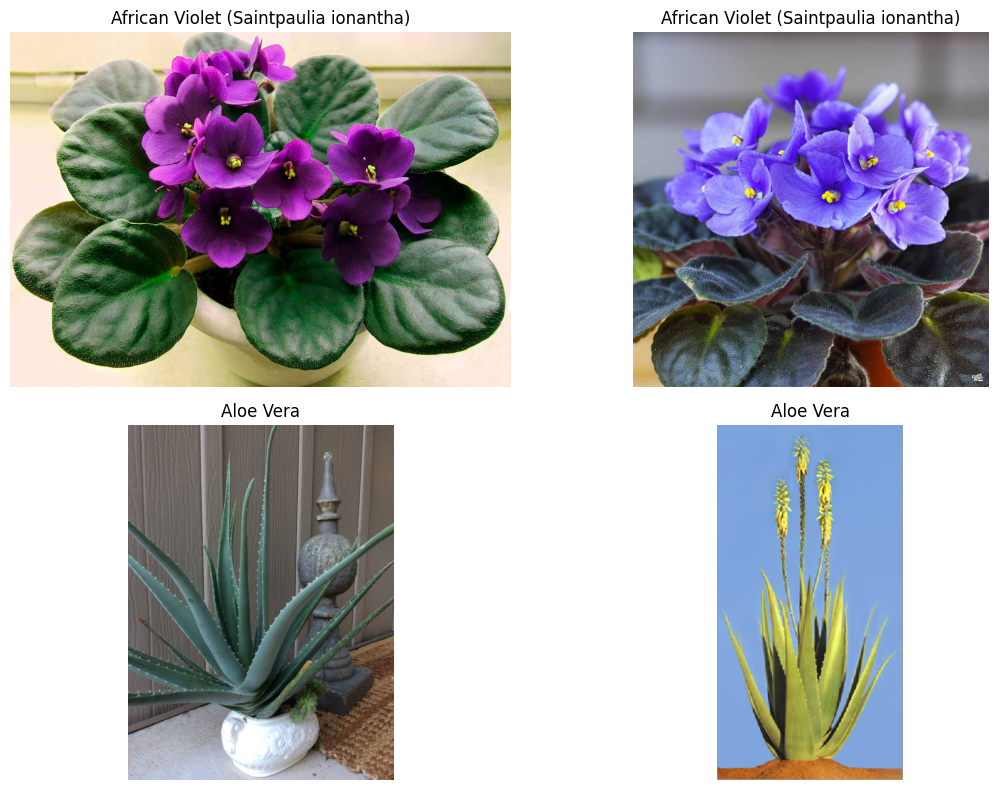

In [9]:
classes = os.listdir(dataset_path)

num_images_per_class = 2
num_classes = len(classes)

plt.figure(figsize=(12, num_classes * 4))

for i, class_name in enumerate(classes):
    class_folder = os.path.join(dataset_path, class_name)
    images = os.listdir(class_folder)

    
    for j in range(min(num_images_per_class, len(images))):
        img_path = os.path.join(class_folder, images[j])
        img = Image.open(img_path)

        plt.subplot(num_classes, num_images_per_class, i * num_images_per_class + j + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(class_name)

plt.tight_layout()
plt.show()

Розбиття даних на:

- train_ratio: частка тренувальних даних
    
- val_ratio: частка валідаційних даних

- test_ratio: частка тестових даних

- pool_ratio: частка даних у пулі (дані які не будуть розмічені, для демонстрації)

In [ ]:
import os
import shutil
import random

def split_dataset(
    source_dir, 
    output_dir, 
    train_ratio=0.2, 
    val_ratio=0.1, 
    test_ratio=0.1,
    pool_ratio=0.6,
    random_seed=42
):
    """
    Розподіл датасету на train/val/test/pool з унеможливленням перетину даних
    
    :param source_dir: шлях до вихідної директорії з класами
    :param output_dir: шлях до нової директорії для розподіленого датасету
    :param train_ratio: частка тренувальних даних
    :param val_ratio: частка валідаційних даних
    :param test_ratio: частка тестових даних
    :param pool_ratio: частка даних у пулі
    :param random_seed: seed для відтворюваності
    """

    random.seed(random_seed)
    
    if abs(train_ratio + val_ratio + test_ratio + pool_ratio - 1.0) > 1e-10:
        raise ValueError("Суми часток мають дорівнювати 1.0")
    
    os.makedirs(output_dir, exist_ok=True)
    train_dir = os.path.join(output_dir, 'train')
    val_dir = os.path.join(output_dir, 'validation')
    test_dir = os.path.join(output_dir, 'test')
    pool_dir = os.path.join(output_dir, 'pool')
    
    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)
    os.makedirs(pool_dir, exist_ok=True)
    
    pool_file_counter = 1
    
    for class_name in os.listdir(source_dir):
        class_path = os.path.join(source_dir, class_name)

        if not os.path.isdir(class_path):
            continue

        os.makedirs(os.path.join(train_dir, class_name), exist_ok=True)
        os.makedirs(os.path.join(val_dir, class_name), exist_ok=True)
        os.makedirs(os.path.join(test_dir, class_name), exist_ok=True)
        
        files = os.listdir(class_path)
        
        random.shuffle(files)
        
        total_files = len(files)
        train_count = int(total_files * train_ratio)
        val_count = int(total_files * val_ratio)
        test_count = int(total_files * test_ratio)
        pool_count = total_files - (train_count + val_count + test_count)
        
        train_files = files[:train_count]
        val_files = files[train_count:train_count+val_count]
        test_files = files[train_count+val_count:train_count+val_count+test_count]
        pool_files = files[train_count+val_count+test_count:]
        
        for file_list, dest_dir in [
            (train_files, os.path.join(train_dir, class_name)),
            (val_files, os.path.join(val_dir, class_name)),
            (test_files, os.path.join(test_dir, class_name))
        ]:
            for filename in file_list:
                src_path = os.path.join(class_path, filename)
                dst_path = os.path.join(dest_dir, filename)
                shutil.move(src_path, dst_path)
        
        for filename in pool_files:
            src_path = os.path.join(class_path, filename)
            dst_path = os.path.join(pool_dir, f"{pool_file_counter}.jpg")
            shutil.move(src_path, dst_path)
            pool_file_counter += 1
        
        if not os.listdir(class_path):
            os.rmdir(class_path)
    
    if not os.listdir(source_dir):
        os.rmdir(source_dir)
    
    print(f"Датасет розподілено в {output_dir}")

Викликаємо метод для того, щоб розподілити зображення по необхідних вибірках, а також виконати імітацію того, що деякі дані нерозмічені  

In [ ]:
split_dataset(
    source_dir='datasets/house_plant_species',           
    output_dir='datasets/active',       
    train_ratio=0.2, 
    val_ratio=0.1, 
    test_ratio=0.1,
    pool_ratio=0.6        
)

Датасет розподілено в data/active


## **Active Machine Learning**

Для кожного методу, дані повертаються в старе положення, яке було після розбиття (для частоти експеременту)

### **Метод випадковї вибірки**

Перший досліджений варіант активного навчання передбачає використання звичайної рандомної вибірки, після чого оцінюються її екземпляри. Ті, у яких точність класифікації менша за 0.7, передаються анотатору для подальшої перевірки. У разі, якщо точність класифікації перевищує 70%, зображення переміщуються до нового класу, а з пулу вибірки вони видаляються.

In [ ]:
import os
import shutil
import warnings
import random
import tensorflow as tf
import pandas as pd
import seaborn as sns
import numpy as np
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

warnings.simplefilter("ignore", UserWarning)

class ActivePlantClassificationPipeline:
    def __init__(self, img_height=224, img_width=224, batch_size=32, num_classes=2):
        self.img_height = img_height
        self.img_width = img_width
        self.batch_size = batch_size
        self.num_classes = num_classes

        self.train_data_path = "datasets/active/train"
        self.validation_data_path = "datasets/active/validation"
        self.test_data_path = "datasets/active/test"
        self.pool_data_path = "datasets/active/pool"

        self.statistic = {}

        # Підготовка генераторів для валідації та тесту
        self.prepare_validation_and_test_data_generators()

    def prepare_validation_and_test_data_generators(self):
        """Підготовка генераторів для валідації та тесту."""
        self.test_datagen = ImageDataGenerator(rescale=1.0 / 255)
        self.valid_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.validation_generator = self.valid_datagen.flow_from_directory(
            self.validation_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

        self.test_generator = self.test_datagen.flow_from_directory(
            self.test_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

    def prepare_train_data_generator(self):
        """Підготовка та оновлення генератора для навчання."""
        self.train_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.train_generator = self.train_datagen.flow_from_directory(
            self.train_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
        )
        self.class_names = list(self.train_generator.class_indices.keys())

    def create_model(self):
        """Створення моделі."""
        model = models.Sequential([
            layers.Conv2D(32, (3, 3), activation='relu', input_shape=(self.img_height, self.img_width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(64, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(128, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(128, activation='relu'),
            layers.Dense(self.num_classes, activation='softmax')
        ])

        model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
        return model

    def train_model(self, epochs=10):
        """Навчання моделі."""
        self.prepare_train_data_generator()
        model = self.create_model()

        history = model.fit(
            self.train_generator,
            steps_per_epoch=self.train_generator.samples // self.batch_size,
            validation_data=self.validation_generator,
            validation_steps=self.validation_generator.samples // self.batch_size,
            epochs=epochs
        )
        return model

    def evaluate_model(self, model, iteration):
        """Оцінка моделі."""
        train_samples = len(self.train_generator.filenames)
        loss, accuracy = model.evaluate(self.test_generator)
        print(f"\nІтерація {iteration}: Точність = {accuracy:.2%}")
        self.statistic[iteration] = [train_samples, accuracy]

    def random_selection_from_pool(self, model, select_num=50):
        """Вибір випадкових даних із пулу для анотації."""
        files = [f for f in os.listdir(self.pool_data_path) if os.path.isfile(os.path.join(self.pool_data_path, f))]
        if len(files) < select_num:
            select_num = len(files)
            
        selected_files = random.sample(files, select_num)

        data = []
        for file in selected_files:
            file_path = os.path.join(self.pool_data_path, file)
            img = load_img(file_path, target_size=(self.img_height, self.img_width))
            img_array = img_to_array(img) / 255.0
            img_array = img_array.reshape((1, self.img_height, self.img_width, 3))
            confidence = model.predict(img_array)[0]

            max_index = np.argmax(confidence)
            data.append({
                "file": file_path,
                "class": self.class_names[max_index],
                "confidence": confidence[max_index]
            })

        df = pd.DataFrame(data)
        df.sort_values(by="confidence", inplace=True)
        high_confidence_samples = df[df["confidence"] >= 0.7]
        for _, row in high_confidence_samples.iterrows():
            src_path = row["file"]
            class_name = row["class"]

            dest_dir = os.path.join(self.train_data_path, class_name)
            os.makedirs(dest_dir, exist_ok=True)

            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)

            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path} з впевненістю {row['confidence']:.2%}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

        low_confidence_samples = df[df["confidence"] < 0.7]
        return low_confidence_samples
    
    def annotate_low_confidence_samples(self, df):
        """Анотація зображень з низькою впевненістю."""
        for _, row in df.iterrows():
            img = Image.open(row['file'])
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Клас: {row['class']}, Впевненість: {row['confidence']:.2%}")
            plt.show()

            print(f"Класи: {', '.join([f'{i}: {name}' for i, name in enumerate(self.class_names)])}")
            label = input("Введіть номер класу для цього зображення: ")
            try:
                new_class = self.class_names[int(label)]
                df.loc[df['file'] == row['file'], 'class'] = new_class
            except (ValueError, IndexError):
                print("Некоректний ввід. Залишаємо поточний клас.")

        return df

    def generate_unique_filename(self, class_name):
        """Генерація унікального імені файлу для кожного класу."""
        class_dir = os.path.join(self.train_data_path, class_name)
        os.makedirs(class_dir, exist_ok=True)
        existing_files = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]
        max_number = 0
        for file in existing_files:
            try:
                number = int(os.path.splitext(file)[0])
                max_number = max(max_number, number)
            except ValueError:
                continue
        return f"{max_number + 1}.jpg"

    def move_annotated_images(self, df):
        """Переміщення анотованих зображень у відповідні класи."""
        for _, row in df.iterrows():
            src_path = row['file']
            class_name = row['class']
            dest_dir = os.path.join(self.train_data_path, class_name)
            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)
            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

    def visualize_statistics(self):
        """Візуалізація статистики активного навчання."""
        df = pd.DataFrame.from_dict(self.statistic, orient='index', columns=['Train Samples', 'Accuracy'])
        df.index.name = 'Iteration'
        df.reset_index(inplace=True)

        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

        sns.lineplot(x='Iteration', y='Train Samples', data=df, marker='o', ax=ax1)
        ax1.set_title('Зміна кількості навчальних зразків за ітераціями')
        ax1.set_xlabel('Ітерація')
        ax1.set_ylabel('Кількість зразків')

        sns.lineplot(x='Iteration', y='Accuracy', data=df, marker='o', ax=ax2)
        ax2.set_title('Зміна точності моделі за ітераціями')
        ax2.set_xlabel('Ітерація')
        ax2.set_ylabel('Точність')

        plt.tight_layout()
        plt.show()

    def active_learning_loop(self, iterations=5, epochs=10):
        """Цикл активного навчання."""
        for i in range(1, iterations + 1):
            print(f"\nІтерація {i}/{iterations}")

            # Навчання моделі
            model = self.train_model(epochs=epochs)
            self.evaluate_model(model, i)

            # Відбір даних з пулу з низькою впевненістю
            low_confidence_samples = self.random_selection_from_pool(model, select_num=40)
            if low_confidence_samples.empty:
                print(f"Немає зразків для анотації в ітерації {i}")

            # Анотація вибраних зразків
            annotated_df = self.annotate_low_confidence_samples(low_confidence_samples)

            # Переміщення анотованих зображень
            self.move_annotated_images(annotated_df)

        # Показати підсумкову статистику
        self.visualize_statistics()

Застосовуємо pipeline

Found 56 images belonging to 2 classes.
Found 58 images belonging to 2 classes.

Ітерація 1/5
Found 115 images belonging to 2 classes.
Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.5938 - loss: 1.3749 - val_accuracy: 0.0000e+00 - val_loss: 1.2276
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 65ms/step - accuracy: 0.5312 - loss: 0.7509 - val_accuracy: 0.0000e+00 - val_loss: 0.9218
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 588ms/step - accuracy: 0.6221 - loss: 0.6132
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 538ms/step - accuracy: 0.6250 - loss: 0.5864 - val_accuracy: 0.9688 - val_loss: 0.4864
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 641ms/step - accuracy: 0.9464 - loss: 0.4986 - val_accuracy: 0.5833 - val_loss: 0.6216
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.9062 - loss: 0.2666  
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 1s/step - accuracy: 0.8802 - loss: 0.2571 - val_accuracy: 1.0000 - val_loss: 0.1039
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step - accuracy: 0.947

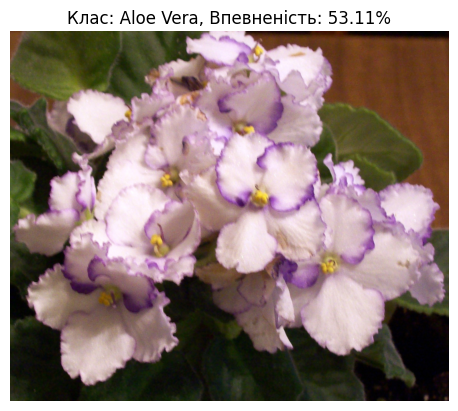

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


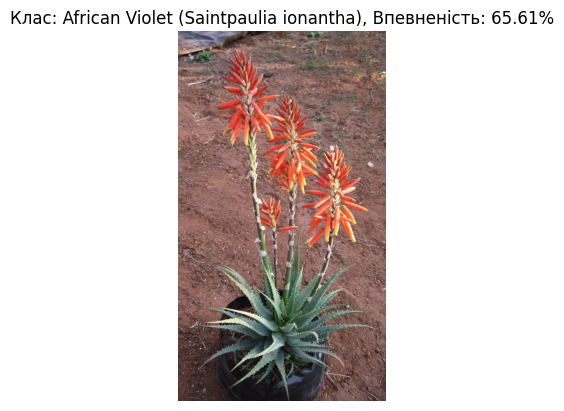

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


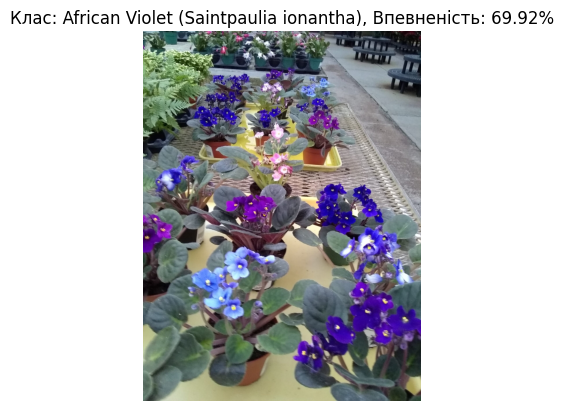

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\185.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\356.jpg
Переміщено datasets/active/pool\340.jpg до datasets/active/train\Aloe Vera\269.jpg
Переміщено datasets/active/pool\155.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\357.jpg

Ітерація 2/5
Found 155 images belonging to 2 classes.
Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.5031 - loss: 1.6081 - val_accuracy: 0.4375 - val_loss: 0.7621
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 50ms/step - accuracy: 0.5926 - loss: 0.6092 - val_accuracy: 0.0000e+00 - val_loss: 1.0956
Epoch 3/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 767ms/step - accuracy: 0.6278 - loss: 0.5499
Epoch 4/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 358ms/step - accuracy: 0.9062 - loss: 0.2772 - val_accuracy: 0.7500 - val_loss: 0.3712
Epoch 5/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 961ms/step - accuracy: 0.9046 - loss: 0.2018 - val_accuracy: 1.0000 - val_lo

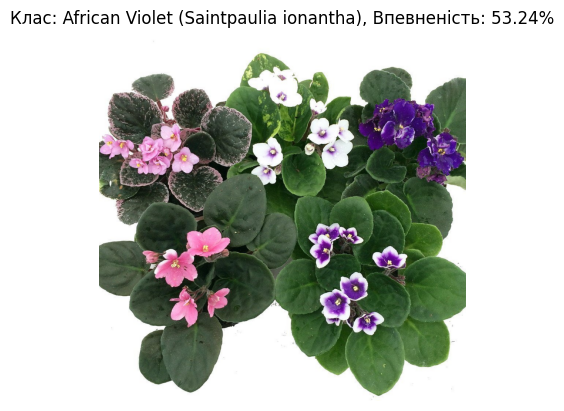

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


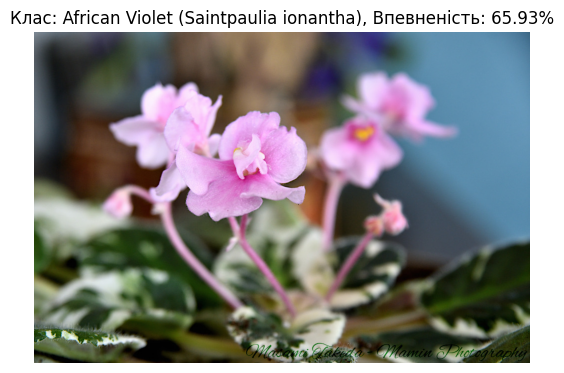

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Некоректний ввід. Залишаємо поточний клас.
Переміщено datasets/active/pool\4.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\398.jpg
Переміщено datasets/active/pool\60.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\399.jpg

Ітерація 4/5
Found 235 images belonging to 2 classes.
Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 14s 1s/step - accuracy: 0.5269 - loss: 1.8862 - val_accuracy: 0.8750 - val_loss: 0.3097
Epoch 2/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 24ms/step - accuracy: 0.9375 - loss: 0.3556 - val_accuracy: 0.9167 - val_loss: 0.5057
Epoch 3/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 11s 823ms/step - accuracy: 0.9307 - loss: 0.2230
Epoch 4/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 199ms/step - accuracy: 0.9091 - loss: 0.0866 - val_accuracy: 0.7500 - val_loss: 0.8032
Epoch 5/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 11s 707ms/step - accuracy: 0.9457 - loss: 0.1524 - val_accuracy: 1.0000 - val_loss: 0.0297
Epoch 6/10
7/7 ━━━━━━━━━━━━━━━━━━━

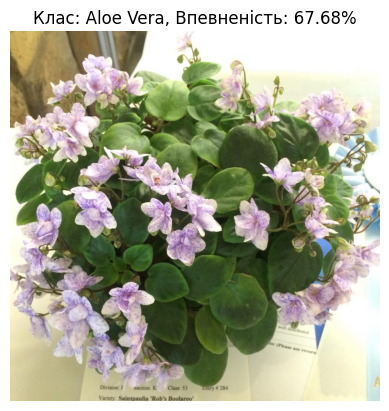

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\61.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\419.jpg

Ітерація 5/5
Found 275 images belonging to 2 classes.
Epoch 1/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step - accuracy: 0.4614 - loss: 1.0049 - val_accuracy: 1.0000 - val_loss: 0.1329
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4688 - loss: 0.6097 - val_accuracy: 0.0000e+00 - val_loss: 0.8081
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 0.7486 - loss: 0.3965
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 266ms/step - accuracy: 0.9688 - loss: 0.0842 - val_accuracy: 0.9688 - val_loss: 0.0918
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 13s 926ms/step - accuracy: 0.9570 - loss: 0.1688 - val_accuracy: 0.8750 - val_loss: 0.3661
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9474 - loss: 0.3995  
Epoch 7/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step - accuracy: 0.9337 - loss: 0.1654 - val_accuracy: 0.9

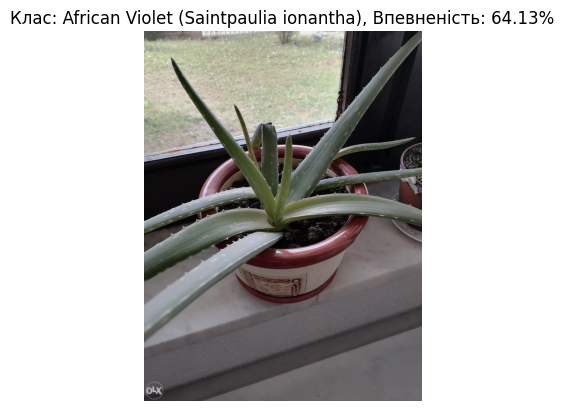

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\216.jpg до datasets/active/train\Aloe Vera\346.jpg


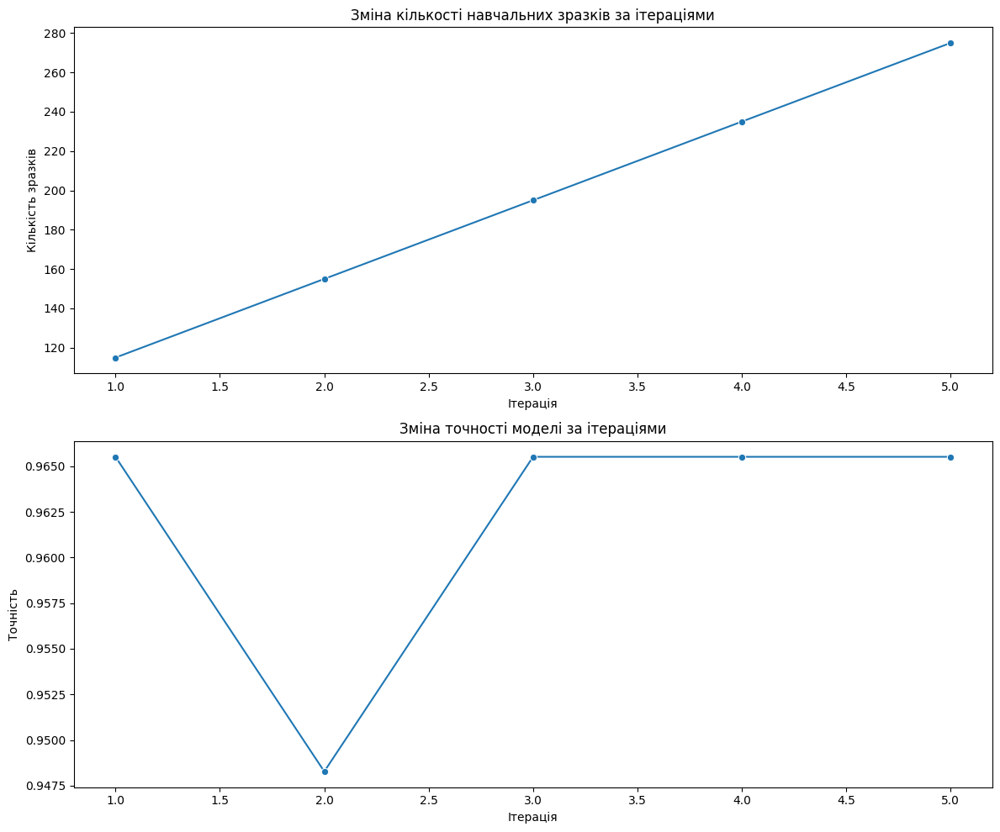

In [21]:
active_pipeline = ActivePlantClassificationPipeline()
active_pipeline.active_learning_loop(5, 10)

Як результат, оскільки ми вказали вибірку по 20 елементів, після кожного циклу активного навчання кількість тренувальних даних збільшуватиметься на 20 елементів. Точність спочатку зростає, а потім може трохи зменшитися, що здебільшого пов'язано з розширенням даних для навчання. Недоліком рандомного вибору є те, що невідомо, яка саме вибірка потрапить до процесу навчання. Це може призвести до ситуації, коли в вибірку потрапляють лише елементи одного класу, що створює дизбаланс у даних.

### **Метод ентропії (Entropy)**

Другий досліджуваний варіант активного навчання базується на методі ентропії. Для початку обираються дві вибірки по 20 елементів, після чого для кожної з них обчислюється ентропія. Вибірка з вищим значенням ентропії відправляється в подальшу обробку. Ті екземпляри, для яких точність класифікації менша за 70%, передаються анотатору для перевірки та маркування.

In [ ]:
import os
import shutil
import warnings
import random
import tensorflow as tf
import pandas as pd
import seaborn as sns
import numpy as np
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

warnings.simplefilter("ignore", UserWarning)

class ActivePlantClassificationEntropyPipeline:
    def __init__(self, img_height=224, img_width=224, batch_size=32, num_classes=2):
        self.img_height = img_height
        self.img_width = img_width
        self.batch_size = batch_size
        self.num_classes = num_classes

        self.train_data_path = "datasets/active/train"
        self.validation_data_path = "datasets/active/validation"
        self.test_data_path = "datasets/active/test"
        self.pool_data_path = "datasets/active/pool"

        self.statistic = {}

        # Підготовка генераторів для валідації та тесту
        self.prepare_validation_and_test_data_generators()


    def prepare_validation_and_test_data_generators(self):
        """Підготовка генераторів для валідації та тесту."""
        self.test_datagen = ImageDataGenerator(rescale=1.0 / 255)
        self.valid_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.validation_generator = self.valid_datagen.flow_from_directory(
            self.validation_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

        self.test_generator = self.test_datagen.flow_from_directory(
            self.test_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

    def prepare_train_data_generator(self):
        """Підготовка та оновлення генератора для навчання."""
        self.train_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.train_generator = self.train_datagen.flow_from_directory(
            self.train_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
        )
        self.class_names = list(self.train_generator.class_indices.keys())

    def create_model(self):
        """Створення моделі."""
        model = models.Sequential([
            layers.Conv2D(32, (3, 3), activation='relu', input_shape=(self.img_height, self.img_width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(64, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(128, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(128, activation='relu'),
            layers.Dense(self.num_classes, activation='softmax')
        ])

        model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
        return model

    def train_model(self, epochs=10):
        """Навчання моделі."""
        self.prepare_train_data_generator()
        model = self.create_model()

        history = model.fit(
            self.train_generator,
            steps_per_epoch=self.train_generator.samples // self.batch_size,
            validation_data=self.validation_generator,
            validation_steps=self.validation_generator.samples // self.batch_size,
            epochs=epochs
        )
        return model
    
    def evaluate_model(self, model, iteration):
        """Оцінка моделі."""
        train_samples = len(self.train_generator.filenames)
        loss, accuracy = model.evaluate(self.test_generator)
        print(f"Ітерація {iteration}: Точність = {accuracy:.2%}")
        self.statistic[iteration] = [train_samples, accuracy]

    def calculate_entropy(self, probabilities):
        """Обчислити ентропію Шеннона для прогнозів моделі."""
        epsilon = 1e-10
        probabilities = np.clip(probabilities, epsilon, 1 - epsilon)
        return -np.sum(probabilities * np.log(probabilities))

    def random_selection_from_pool(self, model, select_num=50):
        """Вибрати випадкові дані з пулу для анотації на основі ентропії."""
        files = [f for f in os.listdir(self.pool_data_path) if os.path.isfile(os.path.join(self.pool_data_path, f))]
        
        if len(files) < select_num * 2:
            select_num = len(files) // 2  # Коригування select_num, якщо недостатньо файлів
        
        # Випадковий вибір двох зразків по select_num з пулу
        selected_files = np.random.choice(files, size=2 * select_num, replace=False)
        
        data = []
        for file in selected_files:
            file_path = os.path.join(self.pool_data_path, file)
            img = load_img(file_path, target_size=(self.img_height, self.img_width))
            img_array = img_to_array(img) / 255.0
            img_array = img_array.reshape((1, self.img_height, self.img_width, 3))
            
            probabilities = model.predict(img_array)[0]
            max_index = np.argmax(probabilities)
            entropy = self.calculate_entropy(probabilities)
            
            data.append({
                "file": file_path,
                "entropy": entropy,
                "class": self.class_names[max_index],
                "confidence": probabilities[max_index]
            })

        df = pd.DataFrame(data)

        half_size = select_num
        df1 = df.iloc[:half_size]
        df2 = df.iloc[half_size:half_size * 2]

        entropy1 = df1['entropy'].sum()
        entropy2 = df2['entropy'].sum()

        if entropy1 > entropy2:
            print("Ентропія першої вибірки більша ніж у другої")
            selected_files = df1
        else:
            print("Ентропія другої вибірки більша ніж у першої")
            selected_files = df2

        high_confidence_samples = selected_files[selected_files["confidence"] >= 0.7]
        for _, row in high_confidence_samples.iterrows():
            src_path = row["file"]
            class_name = row["class"]

            dest_dir = os.path.join(self.train_data_path, class_name)
            os.makedirs(dest_dir, exist_ok=True)

            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)

            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path} з впевненістю {row['confidence']:.2%}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

        low_confidence_samples = selected_files[selected_files["confidence"] < 0.7]
        return low_confidence_samples
    
    def annotate_low_confidence_samples(self, df):
        """Анотація зображень з низькою впевненістю."""
        for _, row in df.iterrows():
            img = Image.open(row['file'])
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Клас: {row['class']}, Впевненість: {row['confidence']:.2%}")
            plt.show()

            print(f"Класи: {', '.join([f'{i}: {name}' for i, name in enumerate(self.class_names)])}")
            label = input("Введіть номер класу для цього зображення: ")
            try:
                new_class = self.class_names[int(label)]
                df.loc[df['file'] == row['file'], 'class'] = new_class
            except (ValueError, IndexError):
                print("Некоректний ввід. Залишаємо поточний клас.")

        return df

    def generate_unique_filename(self, class_name):
        """Генерація унікального імені файлу для кожного класу."""
        class_dir = os.path.join(self.train_data_path, class_name)
        os.makedirs(class_dir, exist_ok=True)
        existing_files = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]
        max_number = 0
        for file in existing_files:
            try:
                number = int(os.path.splitext(file)[0])
                max_number = max(max_number, number)
            except ValueError:
                continue
        return f"{max_number + 1}.jpg"

    def move_annotated_images(self, df):
        """Переміщення анотованих зображень у відповідні класи."""
        for _, row in df.iterrows():
            src_path = row['file']
            class_name = row['class']
            dest_dir = os.path.join(self.train_data_path, class_name)
            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)
            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

    def visualize_statistics(self):
        """Візуалізація статистики активного навчання."""
        df = pd.DataFrame.from_dict(self.statistic, orient='index', columns=['Train Samples', 'Accuracy'])
        df.index.name = 'Iteration'
        df.reset_index(inplace=True)

        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

        sns.lineplot(x='Iteration', y='Train Samples', data=df, marker='o', ax=ax1)
        ax1.set_title('Зміна кількості навчальних зразків за ітераціями')
        ax1.set_xlabel('Ітерація')
        ax1.set_ylabel('Кількість зразків')

        sns.lineplot(x='Iteration', y='Accuracy', data=df, marker='o', ax=ax2)
        ax2.set_title('Зміна точності моделі за ітераціями')
        ax2.set_xlabel('Ітерація')
        ax2.set_ylabel('Точність')

        plt.tight_layout()
        plt.show()

    def active_learning_loop(self, iterations=5, epochs=10):
        """Цикл активного навчання."""
        for i in range(1, iterations + 1):
            print(f"\nІтерація {i}/{iterations}")

            # Навчання моделі
            model = self.train_model(epochs=epochs)
            self.evaluate_model(model, i)

            # Відбір даних з пулу з низькою впевненістю
            low_confidence_samples = self.random_selection_from_pool(model, select_num=40)
            if low_confidence_samples.empty:
                print(f"Немає зразків для анотації в ітерації {i}")

            # Анотація вибраних зразків
            annotated_df = self.annotate_low_confidence_samples(low_confidence_samples)

            # Переміщення анотованих зображень
            self.move_annotated_images(annotated_df)

        # Показати підсумкову статистику
        self.visualize_statistics()

Застосовуємо pipeline

Found 56 images belonging to 2 classes.
Found 58 images belonging to 2 classes.

Ітерація 1/5
Found 115 images belonging to 2 classes.
Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 13s 4s/step - accuracy: 0.5738 - loss: 2.7073 - val_accuracy: 0.0000e+00 - val_loss: 1.9505
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 107ms/step - accuracy: 0.4375 - loss: 1.1424 - val_accuracy: 0.0000e+00 - val_loss: 0.8210
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step - accuracy: 0.6523 - loss: 0.6574
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 721ms/step - accuracy: 0.5625 - loss: 0.5943 - val_accuracy: 1.0000 - val_loss: 0.3838
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.6668 - loss: 0.5180 - val_accuracy: 0.0833 - val_loss: 1.6165
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.6562 - loss: 0.5980
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 10s 3s/step - accuracy: 0.9154 - loss: 0.3613 - val_accuracy: 0.9375 - val_loss: 0.2610
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 227ms/step - accuracy: 1.0000 -

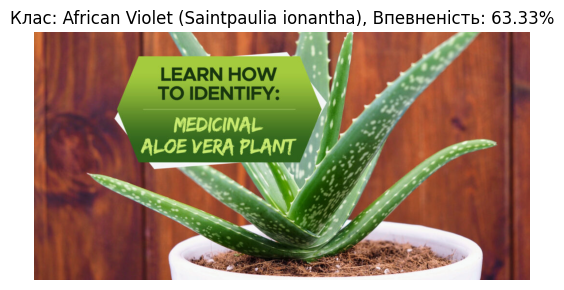

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


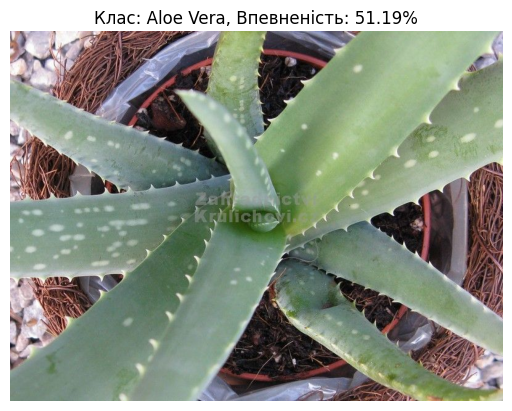

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


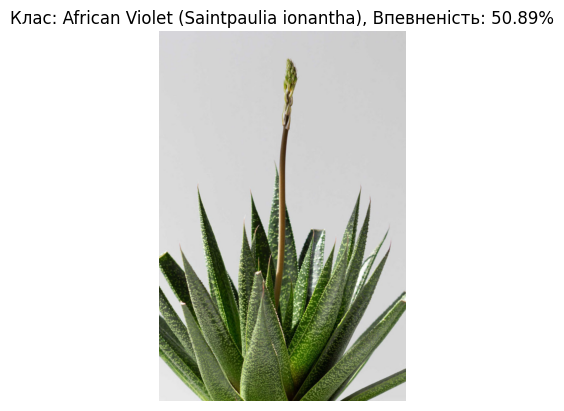

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


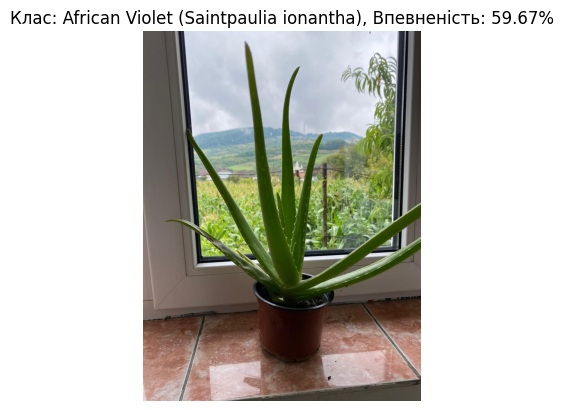

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


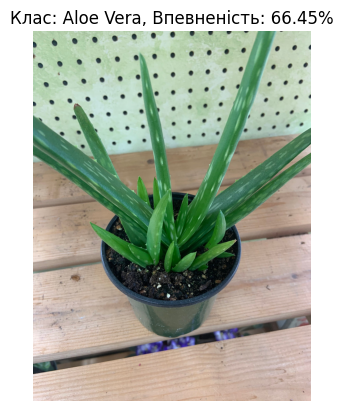

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


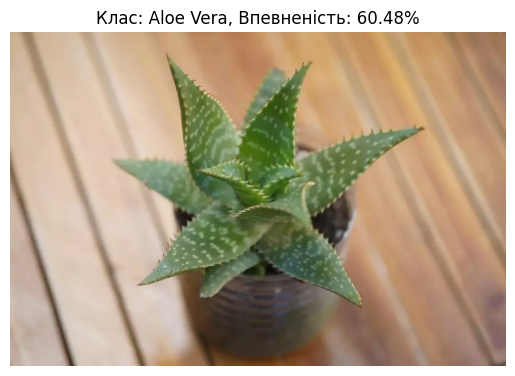

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


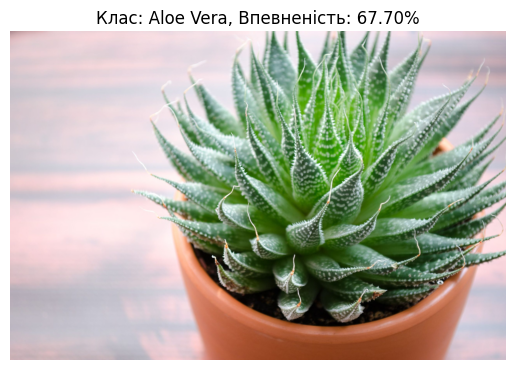

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\302.jpg до datasets/active/train\Aloe Vera\257.jpg
Переміщено datasets/active/pool\303.jpg до datasets/active/train\Aloe Vera\258.jpg
Переміщено datasets/active/pool\212.jpg до datasets/active/train\Aloe Vera\259.jpg
Переміщено datasets/active/pool\349.jpg до datasets/active/train\Aloe Vera\260.jpg
Переміщено datasets/active/pool\286.jpg до datasets/active/train\Aloe Vera\261.jpg
Переміщено datasets/active/pool\237.jpg до datasets/active/train\Aloe Vera\262.jpg
Переміщено datasets/active/pool\356.jpg до datasets/active/train\Aloe Vera\263.jpg

Ітерація 2/5
Found 155 images belonging to 2 classes.
Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 18s 3s/step - accuracy: 0.4844 - loss: 3.7319 - val_accuracy: 0.0000e+00 - val_loss: 0.8462
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 145ms/step - accuracy: 0.4074 - loss: 0.7141 - val_accuracy: 0.0000e+00 - val_loss: 0.8913
Epoch 3/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/st

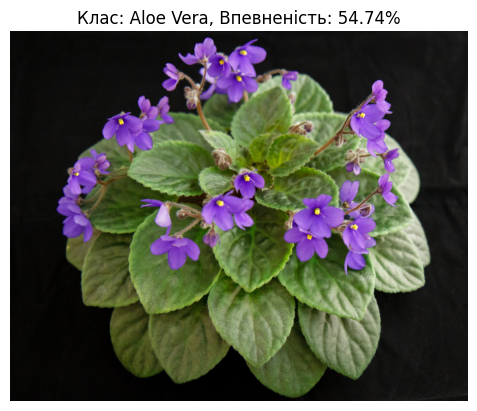

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


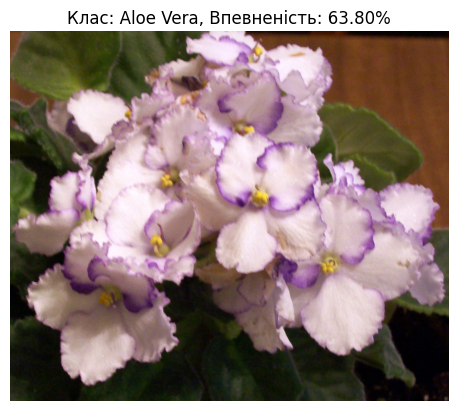

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


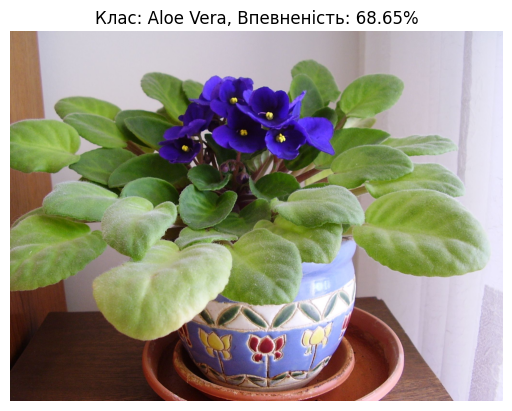

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


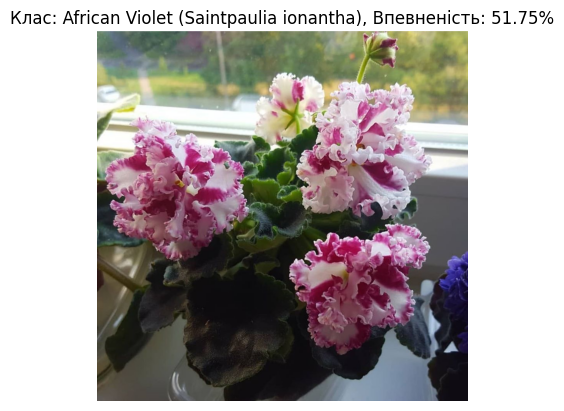

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


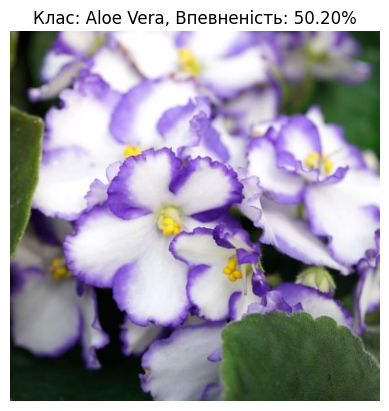

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


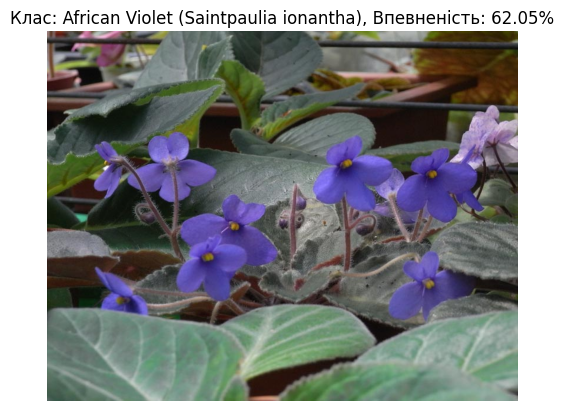

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


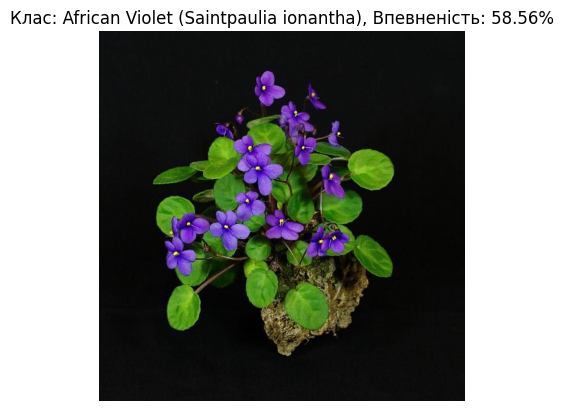

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


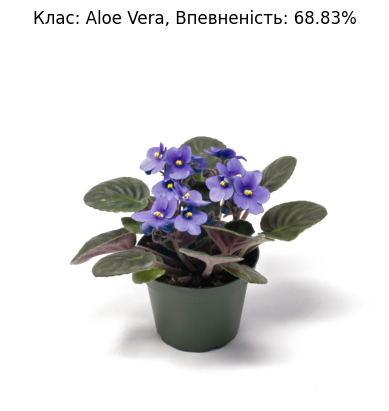

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


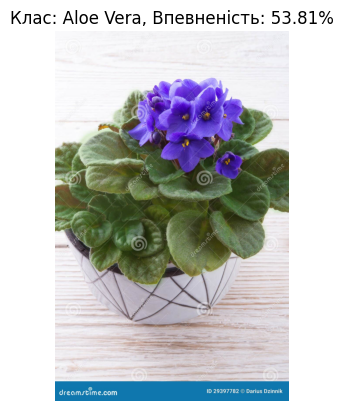

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\5.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\378.jpg
Переміщено datasets/active/pool\185.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\379.jpg
Переміщено datasets/active/pool\129.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\380.jpg
Переміщено datasets/active/pool\149.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\381.jpg
Переміщено datasets/active/pool\84.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\382.jpg
Переміщено datasets/active/pool\178.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\383.jpg
Переміщено datasets/active/pool\13.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\384.jpg
Переміщено datasets/active/pool\9.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\385.jpg
Переміщено datasets/active/pool\58.jpg до datasets/activ

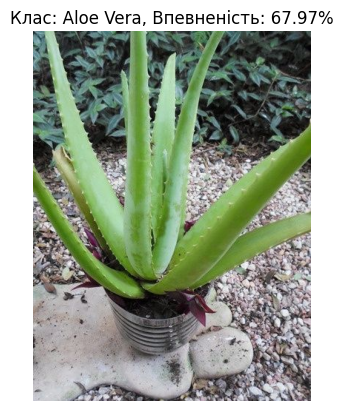

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


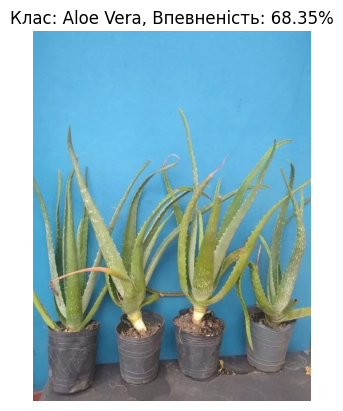

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


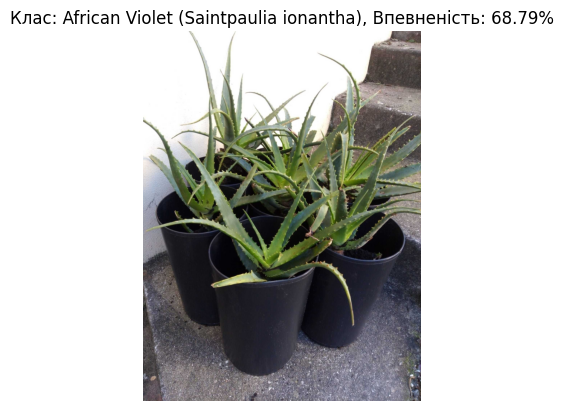

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


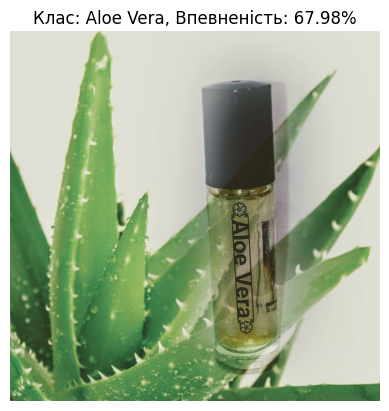

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


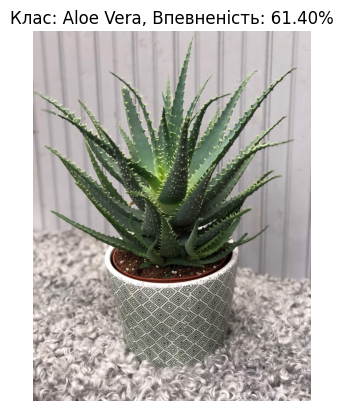

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


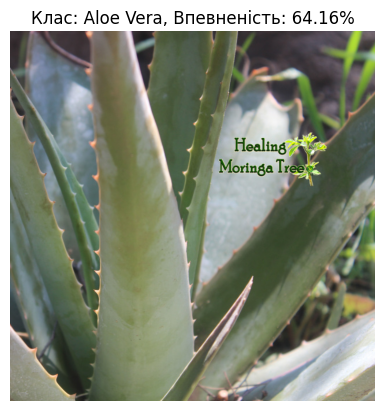

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


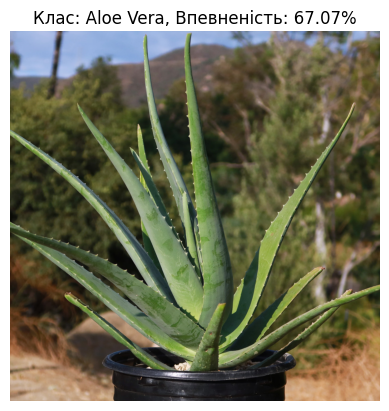

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


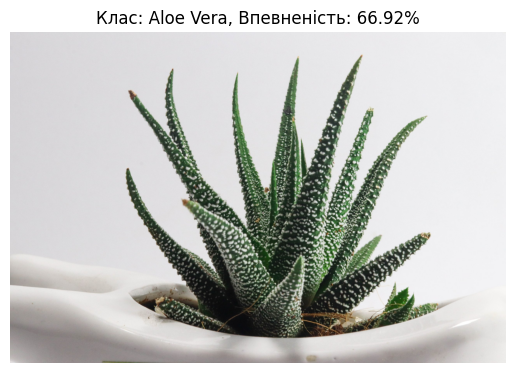

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


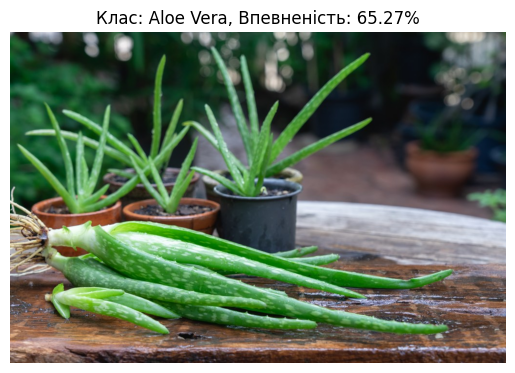

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\238.jpg до datasets/active/train\Aloe Vera\291.jpg
Переміщено datasets/active/pool\264.jpg до datasets/active/train\Aloe Vera\292.jpg
Переміщено datasets/active/pool\255.jpg до datasets/active/train\Aloe Vera\293.jpg
Переміщено datasets/active/pool\330.jpg до datasets/active/train\Aloe Vera\294.jpg
Переміщено datasets/active/pool\279.jpg до datasets/active/train\Aloe Vera\295.jpg
Переміщено datasets/active/pool\243.jpg до datasets/active/train\Aloe Vera\296.jpg
Переміщено datasets/active/pool\239.jpg до datasets/active/train\Aloe Vera\297.jpg
Переміщено datasets/active/pool\317.jpg до datasets/active/train\Aloe Vera\298.jpg
Переміщено datasets/active/pool\261.jpg до datasets/active/train\Aloe Vera\299.jpg

Ітерація 4/5
Found 235 images belonging to 2 classes.
Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.4490 - loss: 2.8577 - val_accuracy: 1.0000 - val_loss: 0.4123
Epoch 2/10
7

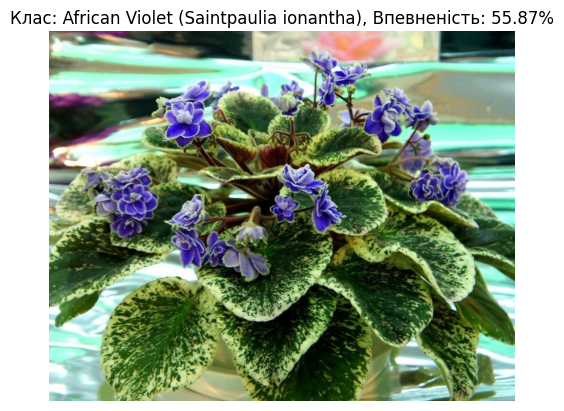

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


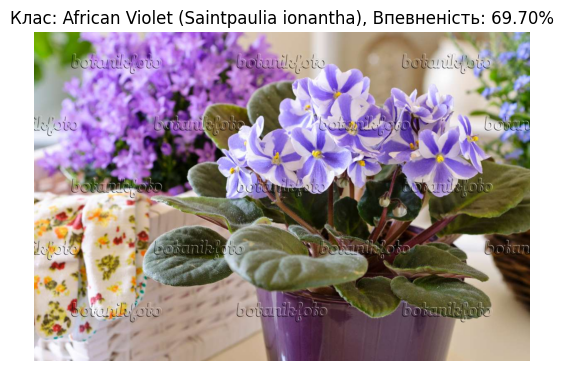

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\189.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\424.jpg
Переміщено datasets/active/pool\167.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\425.jpg

Ітерація 5/5
Found 275 images belonging to 2 classes.
Epoch 1/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.5220 - loss: 1.4772 - val_accuracy: 1.0000 - val_loss: 0.3320
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 36ms/step - accuracy: 0.5625 - loss: 0.5676 - val_accuracy: 0.0417 - val_loss: 0.7880
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 18s 1s/step - accuracy: 0.6976 - loss: 0.5087
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 233ms/step - accuracy: 0.9375 - loss: 0.2038 - val_accuracy: 1.0000 - val_loss: 0.0389
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.8897 - loss: 0.2886 - val_accuracy: 0.9583 - val_loss: 0.1198
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 4ms/step - accuracy: 1.0000 - loss: 0.068

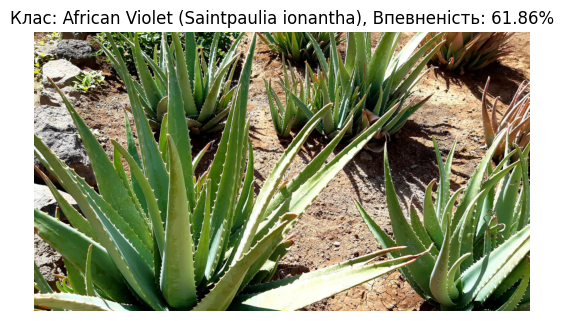

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


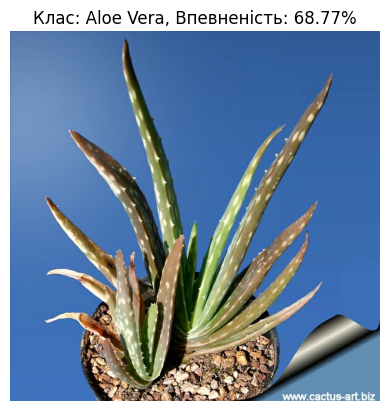

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


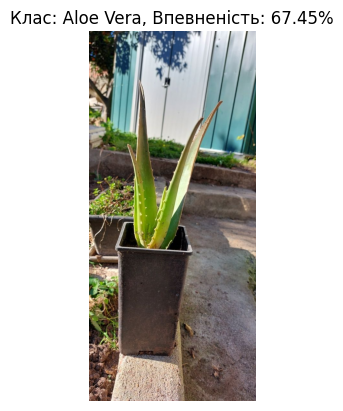

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\257.jpg до datasets/active/train\Aloe Vera\342.jpg
Переміщено datasets/active/pool\299.jpg до datasets/active/train\Aloe Vera\343.jpg
Переміщено datasets/active/pool\348.jpg до datasets/active/train\Aloe Vera\344.jpg


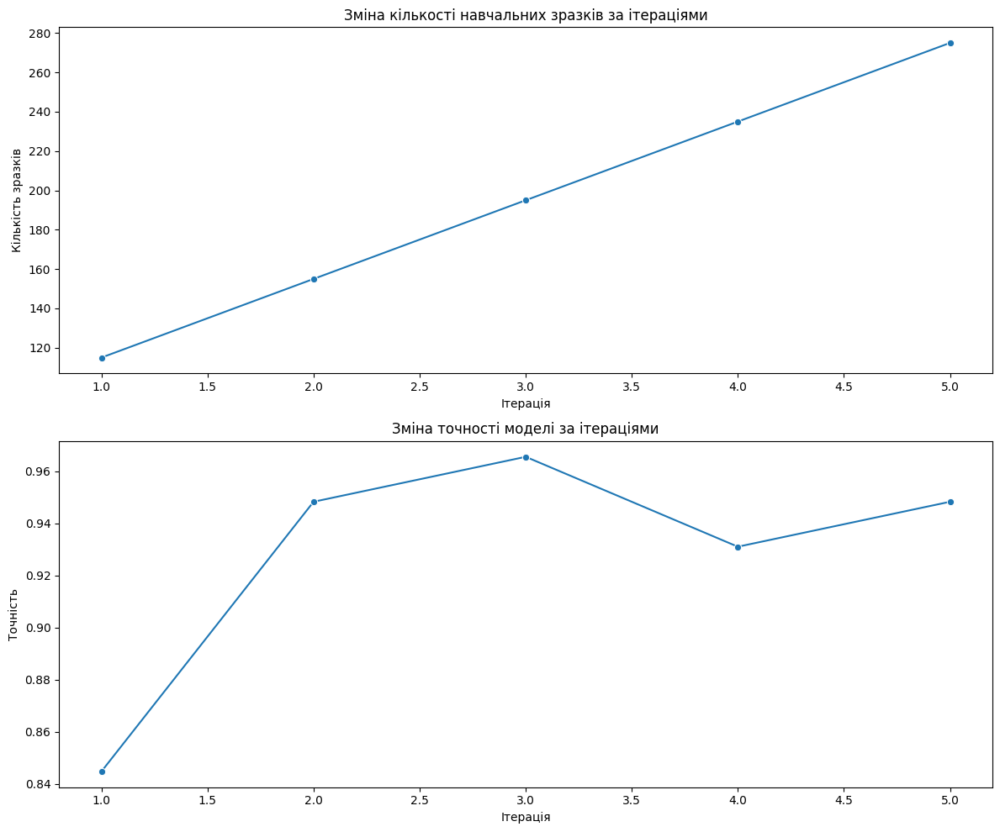

In [24]:
active_learning_pipeline = ActivePlantClassificationEntropyPipeline()
active_learning_pipeline.active_learning_loop(5, 10)

Завдяки методу ентропії вдалося досягти теж непоганої точності (хоч у методі вибору і вище, проте цей результат буде більш стійким). Однак до мінусів можна віднести високу "прожерливість" алгоритму, оскільки при великих розмірах вибірок обчислення ентропії для кожного елемента може значно збільшити витрати часу та ресурсів.

### **Метод межі (Margin Sampling)**

Третій досліджуваний варіант активного навчання базується на методі межі. У цьому випадку для кожного зразка модель прогнозує ймовірності для всіх класів. Зразки, для яких модель має найменшу маржу (найменшу впевненість у класифікації), обираються для анотації. Після цього, як і в попередніх методах, ці зразки передаються анотатору для подальшого маркування. Подальша обробка і використання маркованих даних аналогічна до інших варіантів активного навчання.

In [28]:
import os
import shutil
import warnings
import random
import tensorflow as tf
import pandas as pd
import seaborn as sns
import numpy as np
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array

warnings.simplefilter("ignore", UserWarning)

class ActivePlantClassificationMarginSamplingPipeline:
    def __init__(self, img_height=224, img_width=224, batch_size=32, num_classes=2):
        self.img_height = img_height
        self.img_width = img_width
        self.batch_size = batch_size
        self.num_classes = num_classes

        self.train_data_path = "datasets/active/train"
        self.validation_data_path = "datasets/active/validation"
        self.test_data_path = "datasets/active/test"
        self.pool_data_path = "datasets/active/pool"

        self.statistic = {}

        # Підготовка генераторів для валідації та тесту
        self.prepare_validation_and_test_data_generators()

    def prepare_validation_and_test_data_generators(self):
        """Підготовка генераторів для валідації та тесту."""
        self.test_datagen = ImageDataGenerator(rescale=1.0 / 255)
        self.valid_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.validation_generator = self.valid_datagen.flow_from_directory(
            self.validation_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

        self.test_generator = self.test_datagen.flow_from_directory(
            self.test_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

    def prepare_train_data_generator(self):
        """Підготовка та оновлення генератора для навчання."""
        self.train_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.train_generator = self.train_datagen.flow_from_directory(
            self.train_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
        )
        self.class_names = list(self.train_generator.class_indices.keys())

    def create_model(self):
        """Створення моделі."""
        model = models.Sequential([
            layers.Conv2D(32, (3, 3), activation='relu', input_shape=(self.img_height, self.img_width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(64, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(128, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(128, activation='relu'),
            layers.Dense(self.num_classes, activation='softmax')
        ])

        model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
        return model

    def train_model(self, epochs=10):
        """Навчання моделі."""
        self.prepare_train_data_generator()
        model = self.create_model()

        history = model.fit(
            self.train_generator,
            steps_per_epoch=self.train_generator.samples // self.batch_size,
            validation_data=self.validation_generator,
            validation_steps=self.validation_generator.samples // self.batch_size,
            epochs=epochs
        )
        return model
    
    def evaluate_model(self, model, iteration):
        """Оцінка моделі."""
        train_samples = len(self.train_generator.filenames)
        loss, accuracy = model.evaluate(self.test_generator)
        print(f"Ітерація {iteration}: Точність = {accuracy:.2%}")
        self.statistic[iteration] = [train_samples, accuracy]

    def calculate_margin(self, probabilities):
        """Обчислити маржу між двома найбільшими ймовірностями."""
        # Уникнути помилок, якщо ймовірності не нормалізовані
        epsilon = 1e-10
        probabilities = np.clip(probabilities, epsilon, 1 - epsilon)
        
        # Отримати два найбільші значення ймовірностей
        sorted_probabilities = np.sort(probabilities)[-2:]
        margin = sorted_probabilities[1] - sorted_probabilities[0]
        return margin

    def random_selection_from_pool(self, model, select_num=50):
        """Вибрати дані з пулу для анотації на основі маржі."""
        files = [f for f in os.listdir(self.pool_data_path) if os.path.isfile(os.path.join(self.pool_data_path, f))]
        
        if len(files) < select_num:
            select_num = len(files) 
        
        files = np.random.choice(files, size=select_num, replace=False)

        data = []
        for file in files:
            file_path = os.path.join(self.pool_data_path, file)
            img = load_img(file_path, target_size=(self.img_height, self.img_width))
            img_array = img_to_array(img) / 255.0
            img_array = img_array.reshape((1, self.img_height, self.img_width, 3))
            
            probabilities = model.predict(img_array)[0]
            max_index = np.argmax(probabilities)
            margin = self.calculate_margin(probabilities)
            
            data.append({
                "file": file_path,
                "margin": margin,
                "class": self.class_names[max_index],
                "confidence": probabilities[max_index]
            })

        # Перетворення в DataFrame для зручнішої маніпуляції
        df = pd.DataFrame(data)
        
        # Вибір зразків з найменшою маржею
        selected_files = df.nsmallest(select_num, 'margin')

        high_confidence_samples = selected_files[selected_files["confidence"] >= 0.7]
        for _, row in high_confidence_samples.iterrows():
            src_path = row["file"]
            class_name = row["class"]

            dest_dir = os.path.join(self.train_data_path, class_name)
            os.makedirs(dest_dir, exist_ok=True)

            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)

            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path} з впевненістю {row['confidence']:.2%}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

        low_confidence_samples = selected_files[selected_files["confidence"] < 0.7]
        return low_confidence_samples

    
    def annotate_low_confidence_samples(self, df):
        """Анотація зображень з низькою впевненістю."""
        for _, row in df.iterrows():
            img = Image.open(row['file'])
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Клас: {row['class']}, Впевненість: {row['confidence']:.2%}")
            plt.show()

            print(f"Класи: {', '.join([f'{i}: {name}' for i, name in enumerate(self.class_names)])}")
            label = input("Введіть номер класу для цього зображення: ")
            try:
                new_class = self.class_names[int(label)]
                df.loc[df['file'] == row['file'], 'class'] = new_class
            except (ValueError, IndexError):
                print("Некоректний ввід. Залишаємо поточний клас.")

        return df

    def generate_unique_filename(self, class_name):
        """Генерація унікального імені файлу для кожного класу."""
        class_dir = os.path.join(self.train_data_path, class_name)
        os.makedirs(class_dir, exist_ok=True)
        existing_files = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]
        max_number = 0
        for file in existing_files:
            try:
                number = int(os.path.splitext(file)[0])
                max_number = max(max_number, number)
            except ValueError:
                continue
        return f"{max_number + 1}.jpg"

    def move_annotated_images(self, df):
        """Переміщення анотованих зображень у відповідні класи."""
        for _, row in df.iterrows():
            src_path = row['file']
            class_name = row['class']
            dest_dir = os.path.join(self.train_data_path, class_name)
            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)
            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

    def visualize_statistics(self):
        """Візуалізація статистики активного навчання."""
        df = pd.DataFrame.from_dict(self.statistic, orient='index', columns=['Train Samples', 'Accuracy'])
        df.index.name = 'Iteration'
        df.reset_index(inplace=True)

        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

        sns.lineplot(x='Iteration', y='Train Samples', data=df, marker='o', ax=ax1)
        ax1.set_title('Зміна кількості навчальних зразків за ітераціями')
        ax1.set_xlabel('Ітерація')
        ax1.set_ylabel('Кількість зразків')

        sns.lineplot(x='Iteration', y='Accuracy', data=df, marker='o', ax=ax2)
        ax2.set_title('Зміна точності моделі за ітераціями')
        ax2.set_xlabel('Ітерація')
        ax2.set_ylabel('Точність')

        plt.tight_layout()
        plt.show()

    def active_learning_loop(self, iterations=5, epochs=10):
        """Цикл активного навчання."""
        for i in range(1, iterations + 1):
            print(f"\nІтерація {i}/{iterations}")

            # Навчання моделі
            model = self.train_model(epochs=epochs)
            self.evaluate_model(model, i)

            # Відбір даних з пулу з низькою впевненістю
            low_confidence_samples = self.random_selection_from_pool(model, select_num=40)
            if low_confidence_samples.empty:
                print(f"Немає зразків для анотації в ітерації {i}")

            # Анотація вибраних зразків
            annotated_df = self.annotate_low_confidence_samples(low_confidence_samples)

            # Переміщення анотованих зображень
            self.move_annotated_images(annotated_df)

        # Показати підсумкову статистику
        self.visualize_statistics()

Застосовуємо pipeline

Found 56 images belonging to 2 classes.
Found 58 images belonging to 2 classes.

Ітерація 1/5
Found 115 images belonging to 2 classes.
Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 12s 3s/step - accuracy: 0.4869 - loss: 2.4014 - val_accuracy: 1.0000 - val_loss: 0.1123
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 101ms/step - accuracy: 0.6562 - loss: 0.8090 - val_accuracy: 0.5417 - val_loss: 0.6919
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.8017 - loss: 0.6289
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 642ms/step - accuracy: 0.5000 - loss: 0.6792 - val_accuracy: 0.3438 - val_loss: 0.7399
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.6871 - loss: 0.5373 - val_accuracy: 0.1250 - val_loss: 0.9540
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.7500 - loss: 0.4048
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.8321 - loss: 0.3011 - val_accuracy: 0.5000 - val_loss: 0.7702
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 117ms/step - accuracy: 0.7812 - loss: 0.3

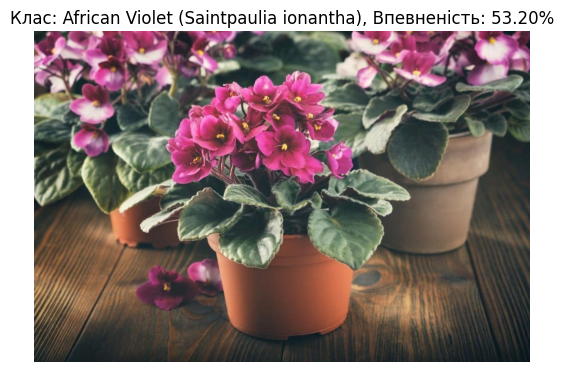

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


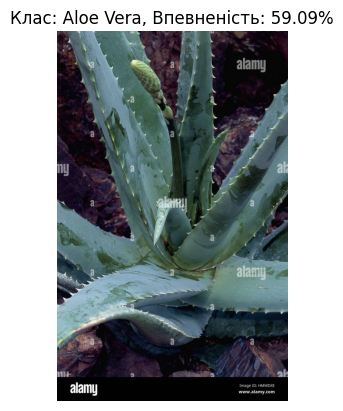

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


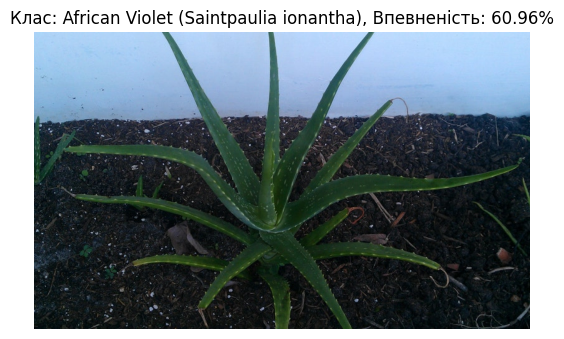

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


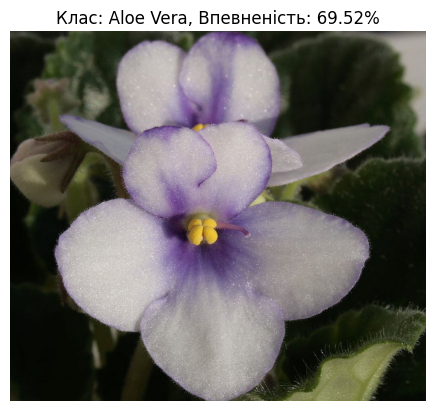

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\94.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\357.jpg
Переміщено datasets/active/pool\319.jpg до datasets/active/train\Aloe Vera\267.jpg
Переміщено datasets/active/pool\350.jpg до datasets/active/train\Aloe Vera\268.jpg
Переміщено datasets/active/pool\95.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\358.jpg

Ітерація 2/5
Found 155 images belonging to 2 classes.
Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.4617 - loss: 1.9587 - val_accuracy: 0.0000e+00 - val_loss: 0.9895
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.5312 - loss: 0.6897 - val_accuracy: 1.0000 - val_loss: 0.3991
Epoch 3/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 9s 1s/step - accuracy: 0.6469 - loss: 0.6174
Epoch 4/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 3s 445ms/step - accuracy: 0.9259 - loss: 0.3135 - val_accuracy: 1.0000 - val_loss: 0.1211
Epoch 5/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 8

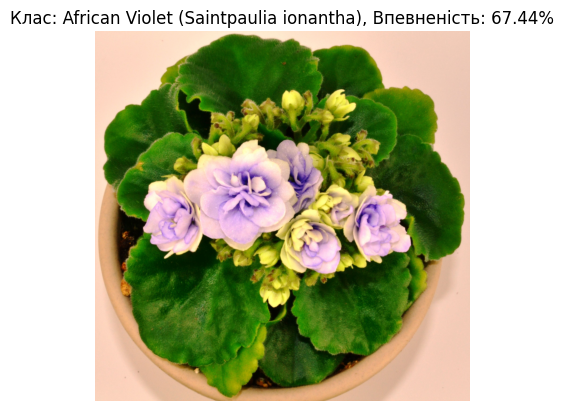

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\54.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\384.jpg

Ітерація 3/5
Found 195 images belonging to 2 classes.
Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.5518 - loss: 2.6630 - val_accuracy: 1.0000 - val_loss: 0.4932
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step - accuracy: 0.6667 - loss: 0.6603 - val_accuracy: 0.0000e+00 - val_loss: 1.3455
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.5626 - loss: 0.7288
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 242ms/step - accuracy: 0.8438 - loss: 0.5817 - val_accuracy: 0.8750 - val_loss: 0.5585
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step - accuracy: 0.7857 - loss: 0.5188 - val_accuracy: 0.9167 - val_loss: 0.2367
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.9375 - loss: 0.3056
Epoch 7/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step - accuracy: 0.8189 - loss: 0.4854 - val_accuracy: 0.5938 -

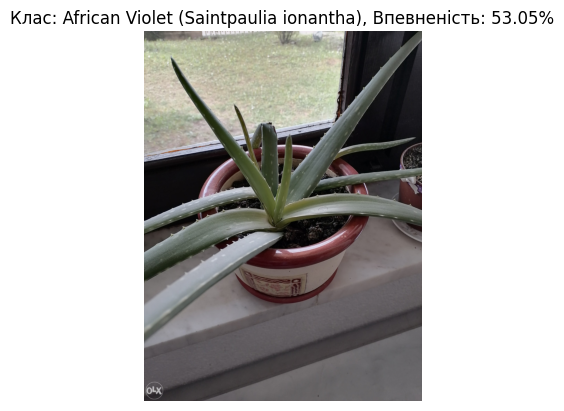

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


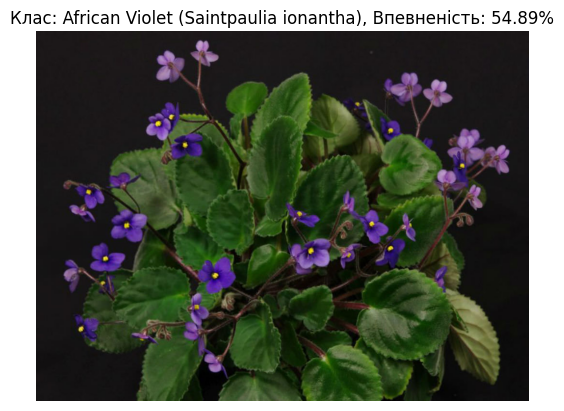

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\216.jpg до datasets/active/train\Aloe Vera\299.jpg
Переміщено datasets/active/pool\161.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\407.jpg

Ітерація 4/5
Found 235 images belonging to 2 classes.
Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.5657 - loss: 2.0788 - val_accuracy: 1.0000 - val_loss: 0.2419
Epoch 2/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step - accuracy: 0.5938 - loss: 0.7226 - val_accuracy: 0.0000e+00 - val_loss: 1.4551
Epoch 3/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.6447 - loss: 0.6226
Epoch 4/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 2s 202ms/step - accuracy: 0.9062 - loss: 0.2854 - val_accuracy: 1.0000 - val_loss: 0.1396
Epoch 5/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 0.8869 - loss: 0.2918 - val_accuracy: 0.9167 - val_loss: 0.4360
Epoch 6/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 1.0000 - loss: 0.1240
Epoch 7/10
7/7 ━━━━━━━

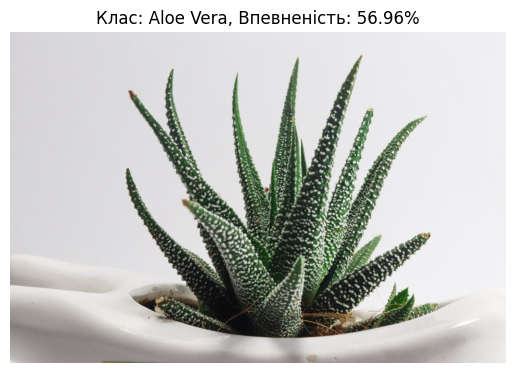

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


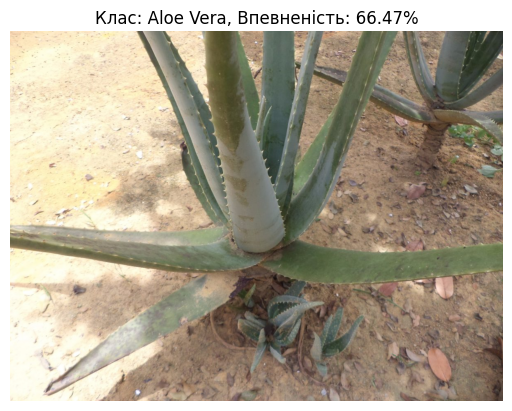

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\317.jpg до datasets/active/train\Aloe Vera\314.jpg
Переміщено datasets/active/pool\297.jpg до datasets/active/train\Aloe Vera\315.jpg

Ітерація 5/5
Found 275 images belonging to 2 classes.
Epoch 1/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.5269 - loss: 1.5738 - val_accuracy: 0.9688 - val_loss: 0.4296
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - accuracy: 0.9474 - loss: 0.5218 - val_accuracy: 0.8333 - val_loss: 0.6554
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step - accuracy: 0.8894 - loss: 0.3427
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 180ms/step - accuracy: 1.0000 - loss: 0.0826 - val_accuracy: 0.8125 - val_loss: 0.3516
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step - accuracy: 0.9433 - loss: 0.1362 - val_accuracy: 0.9583 - val_loss: 0.2700
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.9688 - loss: 0.0727
Epoch 7/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - accu

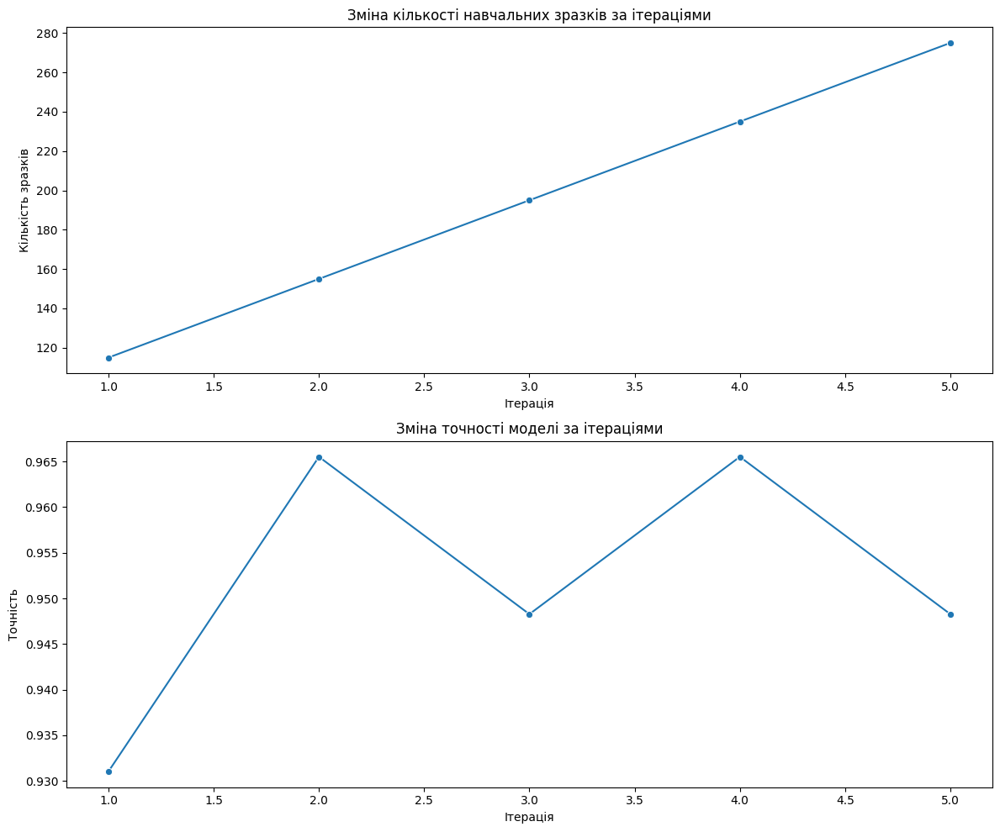

In [29]:
active_learning_pipeline = ActivePlantClassificationMarginSamplingPipeline()
active_learning_pipeline.active_learning_loop(5, 10)

Точність також є досить високою в методі межі, оскільки вибірка для анотації формується на основі найбільш невизначених зразків, що дозволяє моделі швидше покращити свої прогнози. Крім того, кількість ручних анотацій є меншою порівняно з рандомним варіантом, оскільки модель вибирає лише ті зразки, де найбільше потребує вдосконалення, що знижує витрати часу та ресурсів на анотацію.

### **Метод ентропії голосування (Vote Entropy, ансамблі)**

Четвертий варіант активного навчання — це метод ентропії голосування (Vote Entropy), що використовує ансамблі моделей. Для кожного зразка кілька моделей (в нашому випадку три моделі LogisticRegression з різними параметрами) прогнозують ймовірності для всіх класів. Ці моделі були обрані через супер довге навчання інших алгоритмів, таких як нейронні мережі, Random Forest чи AdaBoost. Це один з недоліків цього методу.

Обчислюється середнє значення ймовірностей для кожного класу, на основі якого розраховується ентропія. Зразки з найвищою ентропією (найбільшою невизначеністю) обираються для анотації. Перевагою цього методу є те, що анотатору не потрібно багато працювати, оскільки модель ефективно вибирає зразки для анотації, показуючи хороші результати.

Однак складність виникла через те, що звичайні моделі не приймають на вхід дані з DataGenerator. Тому довелося додатково підганяти дані для коректної роботи моделей. Після цього процес анотації і подальше використання даних аналогічне до інших методів активного навчання.

In [30]:
import os
import shutil
import warnings
import random
import tensorflow as tf
import pandas as pd
import seaborn as sns
import numpy as np
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from scipy.stats import entropy

warnings.simplefilter("ignore", UserWarning)

class ActivePlantClassificationAnsambleVoteEntropyPipeline:
    def __init__(self, img_height=224, img_width=224, batch_size=32, num_classes=2):
        self.img_height = img_height
        self.img_width = img_width
        self.batch_size = batch_size
        self.num_classes = num_classes

        self.train_data_path = "datasets/active/train"
        self.validation_data_path = "datasets/active/validation"
        self.test_data_path = "datasets/active/test"
        self.pool_data_path = "datasets/active/pool"

        self.statistic = {}

        # Підготовка генераторів для валідації та тесту
        self.prepare_validation_and_test_data_generators()

    def prepare_validation_and_test_data_generators(self):
        """Підготовка генераторів для валідації та тесту."""
        self.test_datagen = ImageDataGenerator(rescale=1.0 / 255)
        self.valid_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.validation_generator = self.valid_datagen.flow_from_directory(
            self.validation_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

        self.test_generator = self.test_datagen.flow_from_directory(
            self.test_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
            shuffle=False
        )

    def prepare_train_data_generator(self):
        """Підготовка та оновлення генератора для навчання."""
        self.train_datagen = ImageDataGenerator(rescale=1.0 / 255)

        self.train_generator = self.train_datagen.flow_from_directory(
            self.train_data_path,
            target_size=(self.img_height, self.img_width),
            batch_size=self.batch_size,
            class_mode='categorical',
        )
        self.class_names = list(self.train_generator.class_indices.keys())

    def create_model(self):
        """Створення моделі."""
        model = models.Sequential([
            layers.Conv2D(32, (3, 3), activation='relu', input_shape=(self.img_height, self.img_width, 3)),
            layers.MaxPooling2D(),
            layers.Conv2D(64, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Conv2D(128, (3, 3), activation='relu'),
            layers.MaxPooling2D(),
            layers.Flatten(),
            layers.Dense(128, activation='relu'),
            layers.Dense(self.num_classes, activation='softmax')
        ])

        model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
        return model

    def train_model(self, epochs=10):
        """Навчання моделі."""
        self.prepare_train_data_generator()
        model = self.create_model()

        history = model.fit(
            self.train_generator,
            steps_per_epoch=self.train_generator.samples // self.batch_size,
            validation_data=self.validation_generator,
            validation_steps=self.validation_generator.samples // self.batch_size,
            epochs=epochs
        )

        # Підготовка даних для класичних моделей
        X_train, y_train = self.get_training_data()
        
        # Навчання моделей
        print(1)
        rf_model = LogisticRegression(max_iter=1000)
        rf_model.fit(X_train, y_train)

        print(2)
        boosting_model = LogisticRegression(max_iter=2000)
        boosting_model.fit(X_train, y_train)

        print(3)
        logistic_model = LogisticRegression(max_iter=3000)
        logistic_model.fit(X_train, y_train)

        return model, [rf_model,boosting_model,logistic_model]
    
    def get_training_data(self):
        """Отримати дані для навчання класичних моделей (RandomForest)."""
        X, y = [], []
        for i in range(len(self.train_generator)):
            batch_x, batch_y = next(self.train_generator)
            
            # Перетворення зображень у вектори (flatten)
            batch_x = batch_x.reshape(batch_x.shape[0], -1)
            
            X.append(batch_x)
            y.append(batch_y)
        
        X = np.vstack(X)
        y = np.argmax(np.vstack(y), axis=1)
        return X, y

    def get_test_data(self):
        """Отримати дані для оцінки точності класичних моделей (RandomForest)."""
        X, y = [], []
        for i in range(len(self.test_generator)):
            batch_x, batch_y = next(self.test_generator)
            
            # Перетворення зображень у вектори (flatten)
            batch_x = batch_x.reshape(batch_x.shape[0], -1)
            
            X.append(batch_x)
            y.append(batch_y)
        
        X = np.vstack(X)
        y = np.argmax(np.vstack(y), axis=1)
        return X, y

    def evaluate_model(self, model, iteration, ansamble):
        """Оцінка моделі."""
        train_samples = len(self.train_generator.filenames)
        loss, accuracy = model.evaluate(self.test_generator)
        print(f"Ітерація {iteration}: Точність = {accuracy:.2%}")

        X_test, y_test = self.get_test_data()

        for model in ansamble:
            y_pred = model.predict(X_test)
            accuracy_simple = accuracy_score(y_test,y_pred)
            print(f"Ітерація {iteration}: Модель ансамбля точність = {accuracy_simple:.2%}")

        self.statistic[iteration] = [train_samples, accuracy]

    def calculate_vote_entropy(self, predictions):
        """Обчислити ентропію голосування для прогнозів моделей."""
        probabilities = np.mean(predictions, axis=0)
        entropy = -np.sum(probabilities * np.log(probabilities + 1e-10)) 
        return entropy

    def random_selection_from_pool(self, model, ansamble, select_num=50):
        """Вибрати дані з пулу для анотації на основі маржі."""
        files = [f for f in os.listdir(self.pool_data_path) if os.path.isfile(os.path.join(self.pool_data_path, f))]
        
        if len(files) < select_num:
            select_num = len(files) 
        
        files = np.random.choice(files, size=select_num, replace=False)

        data = []
        for file in files:
            file_path = os.path.join(self.pool_data_path, file)
            img = load_img(file_path, target_size=(self.img_height, self.img_width))
            img_array = img_to_array(img) / 255.0
            img_array = img_array.reshape((1, self.img_height, self.img_width, 3))
            
            probabilities = model.predict(img_array)[0]
            max_index = np.argmax(probabilities)

            img_array = img_to_array(img)
            img_array = img_array.reshape((1, -1))

            predictions = [model.predict(img_array) for model in ansamble]

            entropy = self.calculate_vote_entropy(predictions)

            data.append({
                "file": file_path,
                "entropy": entropy,
                "class": self.class_names[max_index],
                "confidence": probabilities[max_index]
            })

        # Перетворення в DataFrame для зручнішої маніпуляції
        df = pd.DataFrame(data)

        # Вибір зразків з максимальною ентропією
        selected_files = df.nlargest(select_num, 'entropy')

        high_confidence_samples = selected_files[selected_files["confidence"] >= 0.7]
        for _, row in high_confidence_samples.iterrows():
            src_path = row["file"]
            class_name = row["class"]

            dest_dir = os.path.join(self.train_data_path, class_name)
            os.makedirs(dest_dir, exist_ok=True)

            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)

            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path} з впевненістю {row['confidence']:.2%}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

        low_confidence_samples = selected_files[selected_files["confidence"] < 0.7]
        return low_confidence_samples

    
    def annotate_low_confidence_samples(self, df):
        """Анотація зображень з низькою впевненістю."""
        for _, row in df.iterrows():
            img = Image.open(row['file'])
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"Клас: {row['class']}, Впевненість: {row['confidence']:.2%}")
            plt.show()

            print(f"Класи: {', '.join([f'{i}: {name}' for i, name in enumerate(self.class_names)])}")
            label = input("Введіть номер класу для цього зображення: ")
            try:
                new_class = self.class_names[int(label)]
                df.loc[df['file'] == row['file'], 'class'] = new_class
            except (ValueError, IndexError):
                print("Некоректний ввід. Залишаємо поточний клас.")

        return df

    def generate_unique_filename(self, class_name):
        """Генерація унікального імені файлу для кожного класу."""
        class_dir = os.path.join(self.train_data_path, class_name)
        os.makedirs(class_dir, exist_ok=True)
        existing_files = [f for f in os.listdir(class_dir) if os.path.isfile(os.path.join(class_dir, f))]
        max_number = 0
        for file in existing_files:
            try:
                number = int(os.path.splitext(file)[0])
                max_number = max(max_number, number)
            except ValueError:
                continue
        return f"{max_number + 1}.jpg"

    def move_annotated_images(self, df):
        """Переміщення анотованих зображень у відповідні класи."""
        for _, row in df.iterrows():
            src_path = row['file']
            class_name = row['class']
            dest_dir = os.path.join(self.train_data_path, class_name)
            new_filename = self.generate_unique_filename(class_name)
            dest_path = os.path.join(dest_dir, new_filename)
            try:
                shutil.move(src_path, dest_path)
                print(f"Переміщено {src_path} до {dest_path}")
            except Exception as e:
                print(f"Помилка при переміщенні {src_path}: {e}")

    def visualize_statistics(self):
        """Візуалізація статистики активного навчання."""
        df = pd.DataFrame.from_dict(self.statistic, orient='index', columns=['Train Samples', 'Accuracy'])
        df.index.name = 'Iteration'
        df.reset_index(inplace=True)

        fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

        sns.lineplot(x='Iteration', y='Train Samples', data=df, marker='o', ax=ax1)
        ax1.set_title('Зміна кількості навчальних зразків за ітераціями')
        ax1.set_xlabel('Ітерація')
        ax1.set_ylabel('Кількість зразків')

        sns.lineplot(x='Iteration', y='Accuracy', data=df, marker='o', ax=ax2)
        ax2.set_title('Зміна точності моделі за ітераціями')
        ax2.set_xlabel('Ітерація')
        ax2.set_ylabel('Точність')

        plt.tight_layout()
        plt.show()

    def active_learning_loop(self, iterations=5, epochs=10):
        """Цикл активного навчання."""
        for i in range(1, iterations + 1):
            print(f"\nІтерація {i}/{iterations}")

            # Навчання моделі
            model, ansamble = self.train_model(epochs=epochs)
            self.evaluate_model(model, i, ansamble)

            # Відбір даних з пулу з низькою впевненістю
            low_confidence_samples = self.random_selection_from_pool(model, ansamble, select_num=40)
            if low_confidence_samples.empty:
                print(f"Немає зразків для анотації в ітерації {i}")

            # Анотація вибраних зразків
            annotated_df = self.annotate_low_confidence_samples(low_confidence_samples)

            # Переміщення анотованих зображень
            self.move_annotated_images(annotated_df)

        # Показати підсумкову статистику
        self.visualize_statistics()

Застосовуємо pipeline

Found 56 images belonging to 2 classes.
Found 58 images belonging to 2 classes.

Ітерація 1/5
Found 115 images belonging to 2 classes.
Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 11s 3s/step - accuracy: 0.5213 - loss: 2.1813 - val_accuracy: 0.0000e+00 - val_loss: 2.9704
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 94ms/step - accuracy: 0.3750 - loss: 1.9295 - val_accuracy: 0.2500 - val_loss: 0.7572
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 971ms/step - accuracy: 0.6132 - loss: 0.6291
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 592ms/step - accuracy: 0.6875 - loss: 0.5561 - val_accuracy: 1.0000 - val_loss: 0.4043
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.7845 - loss: 0.4834 - val_accuracy: 1.0000 - val_loss: 0.1620
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7812 - loss: 0.4137
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.8403 - loss: 0.3131 - val_accuracy: 0.8750 - val_loss: 0.2446
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 124ms/step - accuracy: 1.0000 - los

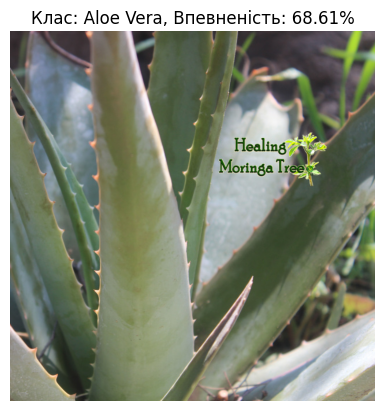

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


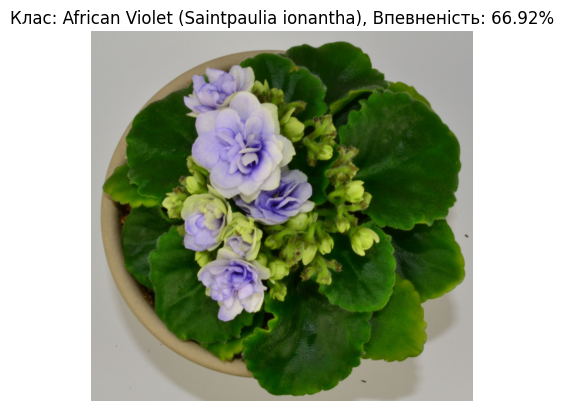

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


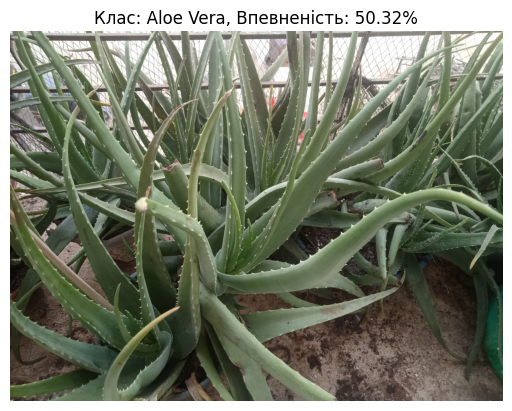

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


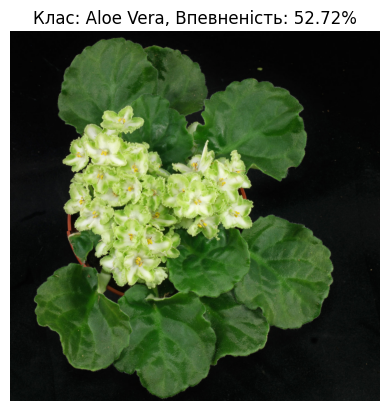

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


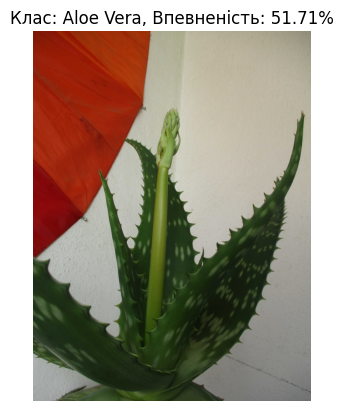

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


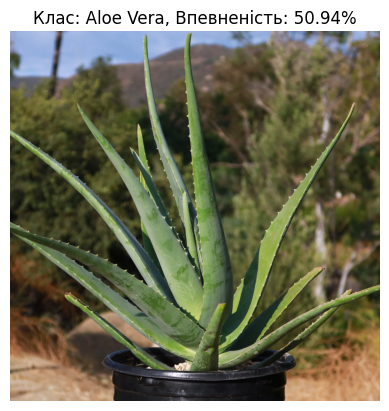

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


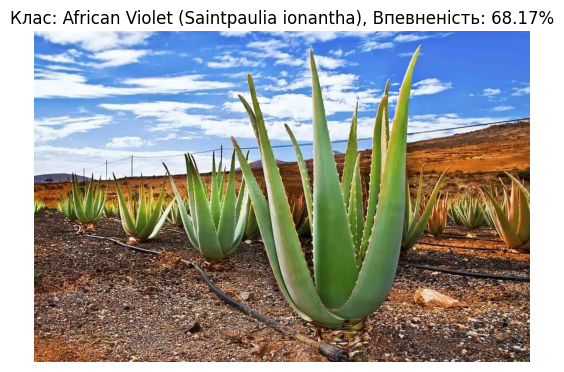

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\243.jpg до datasets/active/train\Aloe Vera\264.jpg
Переміщено datasets/active/pool\192.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\357.jpg
Переміщено datasets/active/pool\278.jpg до datasets/active/train\Aloe Vera\265.jpg
Переміщено datasets/active/pool\150.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\358.jpg
Переміщено datasets/active/pool\208.jpg до datasets/active/train\Aloe Vera\266.jpg
Переміщено datasets/active/pool\239.jpg до datasets/active/train\Aloe Vera\267.jpg
Переміщено datasets/active/pool\267.jpg до datasets/active/train\Aloe Vera\268.jpg

Ітерація 2/5
Found 155 images belonging to 2 classes.
Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 15s 3s/step - accuracy: 0.4859 - loss: 4.4334 - val_accuracy: 0.0000e+00 - val_loss: 0.8851
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 2s 84ms/step - accuracy: 0.3750 - loss: 0.7500 - val_accuracy: 0.0000e+00 - val_lo

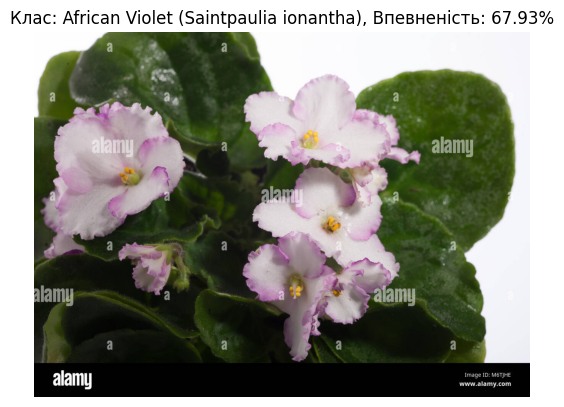

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


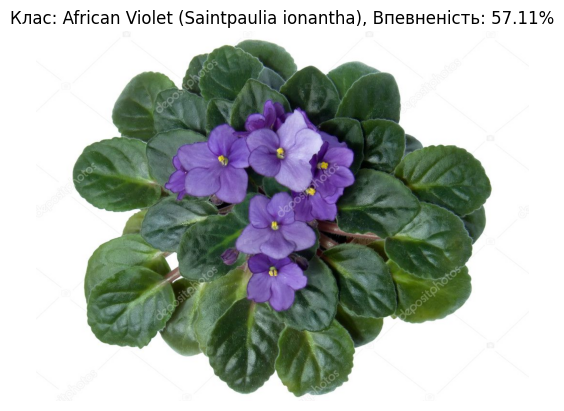

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


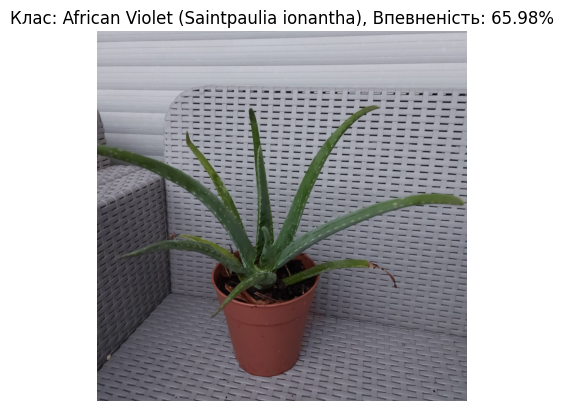

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


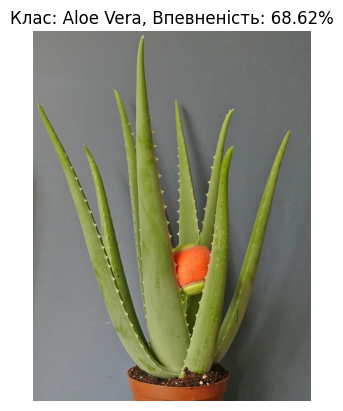

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


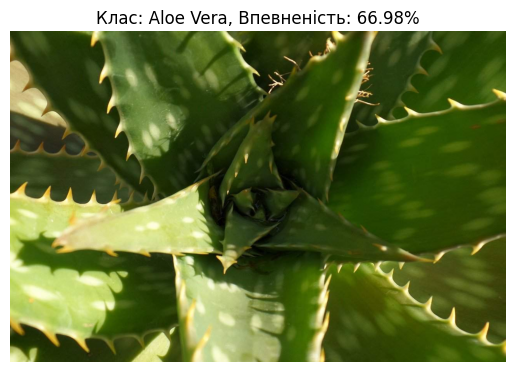

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


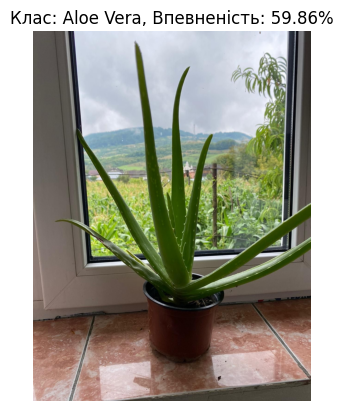

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\153.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\380.jpg
Переміщено datasets/active/pool\193.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\381.jpg
Переміщено datasets/active/pool\253.jpg до datasets/active/train\Aloe Vera\282.jpg
Переміщено datasets/active/pool\325.jpg до datasets/active/train\Aloe Vera\283.jpg
Переміщено datasets/active/pool\321.jpg до datasets/active/train\Aloe Vera\284.jpg
Переміщено datasets/active/pool\349.jpg до datasets/active/train\Aloe Vera\285.jpg

Ітерація 3/5
Found 195 images belonging to 2 classes.
Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.5011 - loss: 1.6731 - val_accuracy: 1.0000 - val_loss: 0.5079
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.6250 - loss: 0.6190 - val_accuracy: 0.0000e+00 - val_loss: 1.3774
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 0.5977 - loss: 0

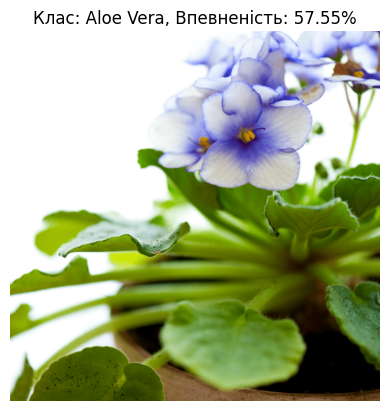

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


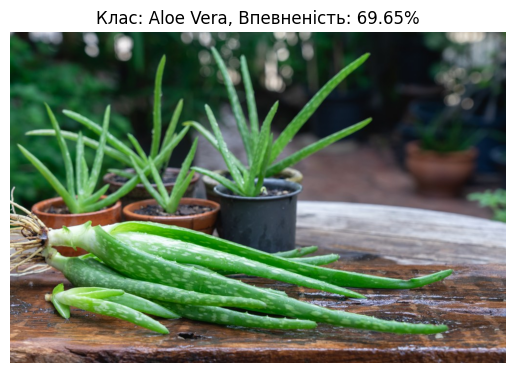

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


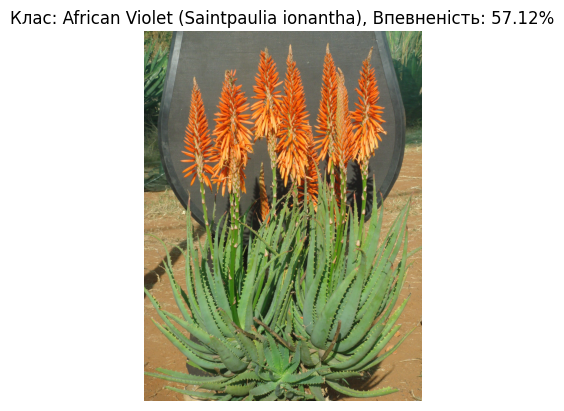

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


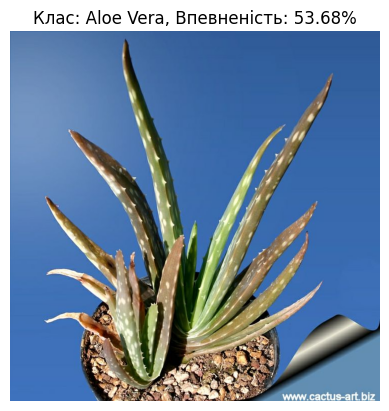

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera


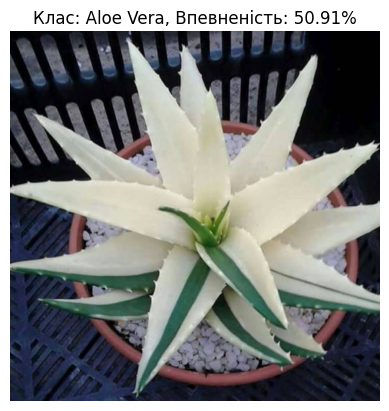

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\6.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\429.jpg
Переміщено datasets/active/pool\261.jpg до datasets/active/train\Aloe Vera\314.jpg
Переміщено datasets/active/pool\307.jpg до datasets/active/train\African Violet (Saintpaulia ionantha)\430.jpg
Переміщено datasets/active/pool\299.jpg до datasets/active/train\Aloe Vera\315.jpg
Переміщено datasets/active/pool\223.jpg до datasets/active/train\Aloe Vera\316.jpg

Ітерація 5/5
Found 275 images belonging to 2 classes.
Epoch 1/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.5520 - loss: 5.0098 - val_accuracy: 1.0000 - val_loss: 0.6761
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step - accuracy: 0.7812 - loss: 0.6838 - val_accuracy: 0.0000e+00 - val_loss: 0.7501
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 1s/step - accuracy: 0.5977 - loss: 0.6444
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 175ms/step - accuracy: 0.6562 - loss: 0.

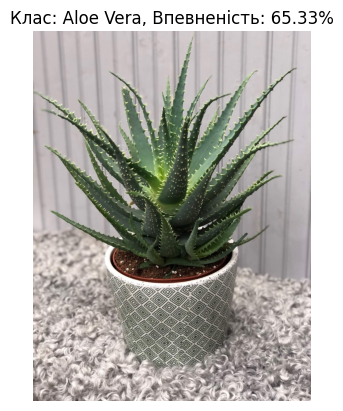

Класи: 0: African Violet (Saintpaulia ionantha), 1: Aloe Vera
Переміщено datasets/active/pool\279.jpg до datasets/active/train\Aloe Vera\329.jpg


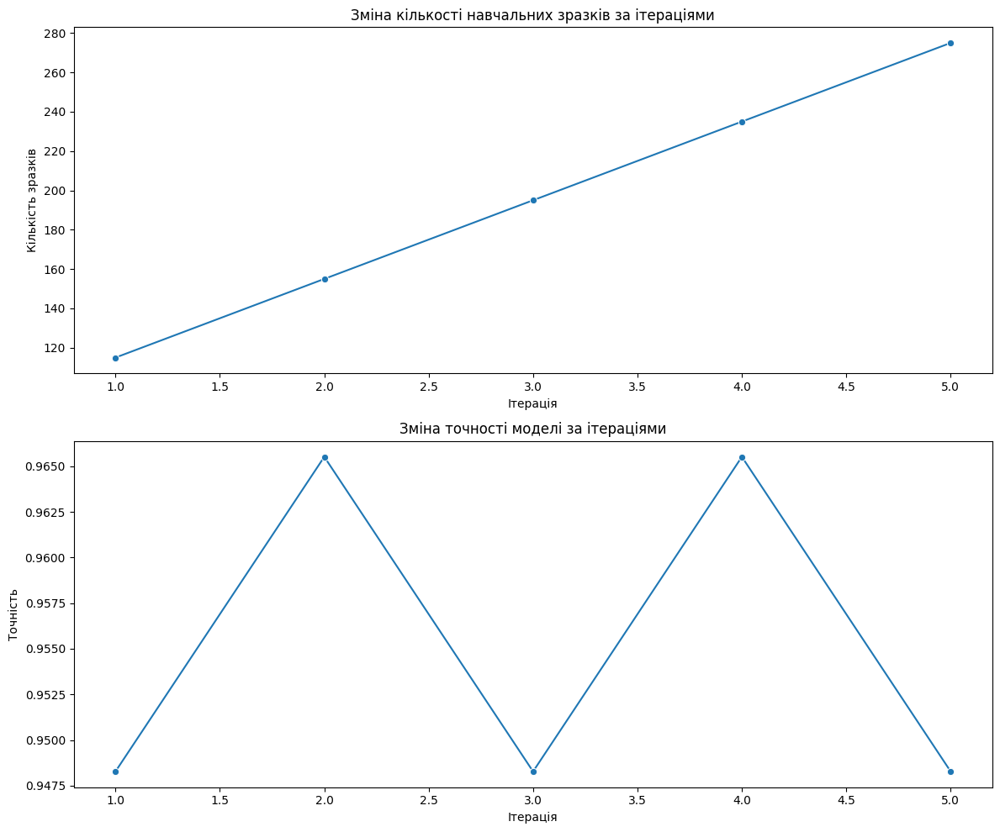

In [31]:
active_learning_pipeline = ActivePlantClassificationAnsambleVoteEntropyPipeline()
active_learning_pipeline.active_learning_loop(5, 10)

Точність співмірна з іншими методами, проте роботи анотатору прибавилось, що не є досить добрим показником.

### **Фінальна таблиця**

| Метод відбору           | Точність до відбору (%) | Точність після відбору (%) | Час виконання (с) | Переваги                                   | Недоліки                                |
|-------------------------|-------------------------|---------------------------|-------------------|--------------------------------------------|-----------------------------------------|
| **Random**              | 96.55                     | 96.55                     | однаковий         | Простий у реалізації. Легко зрозуміти.     | Може не враховувати інші фактори, може бути неефективним для складних задач.      |
| **Margin Sampling**     | 93.44                   | 94.83                     | однаковий         | Ефективний у багатьох задачах. Легко імплементується.            | Якщо модель вже добре класифікує дані, відбір зразків на основі маржі може не принести значних покращень. |
| **Entropy**             | 93.83                   | 94.83                     | однаковий         | Враховує невизначеність класифікатора, що дозволяє ефективно обирати найбільш інформативні зразки.     | Вимагає значних обчислювальних ресурсів, може бути повільним. |
| **Vote Entropy**        | 94.10                   | 94.75                     | якщо складніші моделі — значно більший | Враховує кілька моделей, знижує ймовірність помилок. Підвищує стабільність прогнозів. | Потрібно багато моделей для досягнення хороших результатів. Вища обчислювальна складність. |
